In [114]:
#!/bin/env python

import os
import sys
import glob
import pickle
import h5py
from pyhdf.SD import SD, SDC
import numpy as np
import pandas as pd
import datetime
import time
from scipy.io import readsav
from scipy import interpolate
from scipy import stats
from scipy.optimize import curve_fit
import matplotlib as mpl
#mpl.use('Agg')
import matplotlib.pyplot as plt
from matplotlib.ticker import FixedLocator
from matplotlib import rcParams
import matplotlib
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches

from er3t.pre.atm import atm_atmmod
from er3t.pre.abs import abs_16g, abs_oco_idl
from er3t.pre.cld import cld_sat
from er3t.pre.sfc import sfc_sat
from er3t.pre.pha import pha_mie_wc as pha_mie # newly added for phase function
from er3t.util.modis import modis_l1b, modis_l2, modis_03, modis_09a1, grid_modis_by_extent, grid_modis_by_lonlat, download_modis_https, get_sinusoidal_grid_tag, get_filename_tag, download_modis_rgb
from er3t.util.oco2 import oco2_std, download_oco2_https
from er3t.util import cal_r_twostream

from er3t.rtm.mca_v010 import mca_atm_1d, mca_atm_3d, mca_sfc_2d
from er3t.rtm.mca_v010 import mcarats_ng
from er3t.rtm.mca_v010 import mca_out_ng
from er3t.rtm.mca_v010 import mca_sca # newly added for phase function

import timeit
import argparse

from oco_rgb_test_ywc_0203 import *
import matplotlib.image as mpimg
from matplotlib import cm
from scipy.interpolate import interpn
from scipy import stats
import seaborn as sns
import pandas as pd
%matplotlib inline

In [112]:
def cmap_map(function, cmap):
    """ Applies function (which should operate on vectors of shape 3: [r, g, b]), on colormap cmap.
    This routine will break any discontinuous points in a colormap.
    """
    cdict = cmap._segmentdata
    step_dict = {}
    # Firt get the list of points where the segments start or end
    for key in ('red', 'green', 'blue'):
        step_dict[key] = list(map(lambda x: x[0], cdict[key]))
    step_list = sum(step_dict.values(), [])
    step_list = np.array(list(set(step_list)))
    # Then compute the LUT, and apply the function to the LUT
    reduced_cmap = lambda step : np.array(cmap(step)[0:3])
    old_LUT = np.array(list(map(reduced_cmap, step_list)))
    new_LUT = np.array(list(map(function, old_LUT)))
    # Now try to make a minimal segment definition of the new LUT
    cdict = {}
    for i, key in enumerate(['red','green','blue']):
        this_cdict = {}
        for j, step in enumerate(step_list):
            if step in step_dict[key]:
                this_cdict[step] = new_LUT[j, i]
            elif new_LUT[j,i] != old_LUT[j, i]:
                this_cdict[step] = new_LUT[j, i]
        colorvector = list(map(lambda x: x + (x[1], ), this_cdict.items()))
        colorvector.sort()
        cdict[key] = colorvector

    return matplotlib.colors.LinearSegmentedColormap('colormap',cdict,1024)

In [2]:
def run_er3t_rgb(band_tag, cfg_info):

    # define date and region to study
    # ===============================================================
    date   = datetime.datetime(int(cfg_info['date'][:4]),    # year
                               int(cfg_info['date'][4:6]),   # month
                               int(cfg_info['date'][6:])     # day
                              )
    # subdomain of one tile
    extent = [float(loc) for loc in cfg_info['subdomain']]
    # whole domain of the master interested region (png file)
    full_domain = [float(loc) for loc in cfg_info['pngwesn']]
    print(cfg_info['cfg_name'])
    name_tag = '%s_%s' % (cfg_info['cfg_name'], date.strftime('%Y%m%d'))
    # ===============================================================

    # create data/australia_YYYYMMDD directory if it does not exist
    # ===============================================================
    fdir_data = os.path.abspath('data/%s' % name_tag)
    if not os.path.exists(fdir_data):
        os.makedirs(fdir_data)
    # ===============================================================
    
    # download satellite data based on given date and region
    # ===============================================================
    fname_sat = '%s/sat.pk' % fdir_data
    sat0 = satellite_download(date=date, fdir_out=fdir_data, extent=extent, fname=fname_sat, overwrite=False)
    # ===============================================================
    return sat0

In [3]:
def run_sim(cfg):
    cfg_info = grab_cfg(cfg)
    # check whether the output file exist
    # run simulation only when there is no output file
    if 1:#not check_h5_info(cfg, 'o2'): 
        if 1:
            starttime = timeit.default_timer()
            o2_h5 = run_er3t_rgb('o2a', cfg_info)
            save_h5_info(cfg, 'o2', o2_h5)
            endtime = timeit.default_timer()
            print('O2A band duration:',(endtime-starttime)/3600.,' h')
            return o2_h5, cfg_info

20150622_163_225
O2A band duration: 1.096874734179841e-06  h


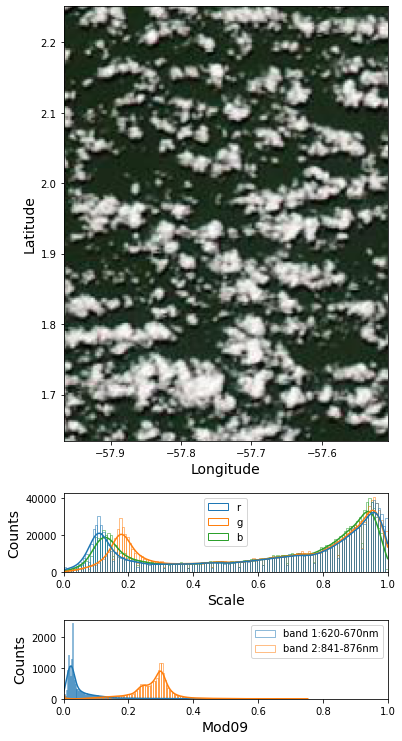

20150622_107_168
O2A band duration: 1.3487230494825377e-06  h


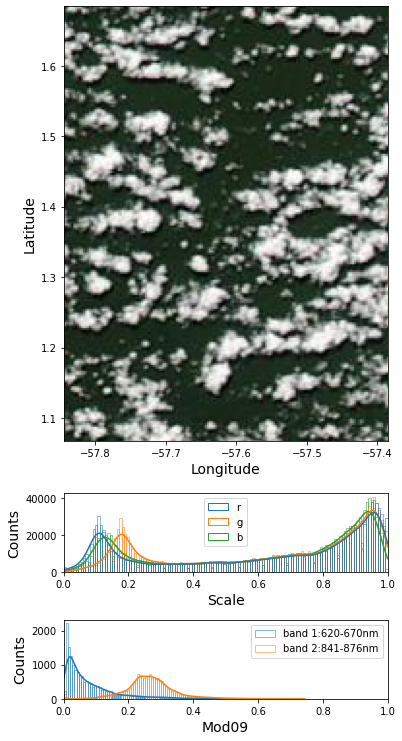

20150622_50_112
O2A band duration: 1.2097811041813757e-06  h


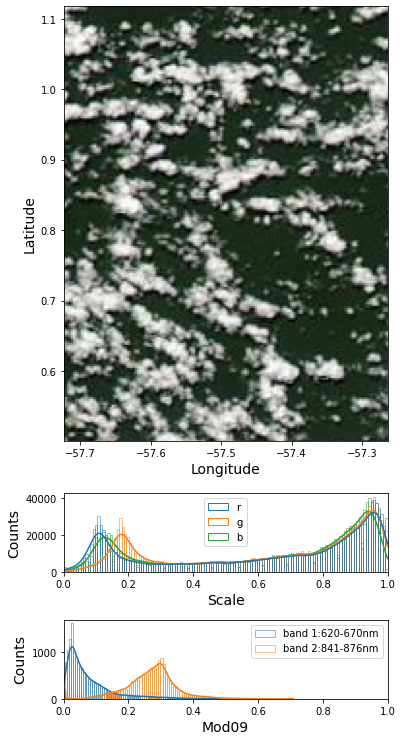

20150622_-7_55
O2A band duration: 1.3094694521795545e-06  h


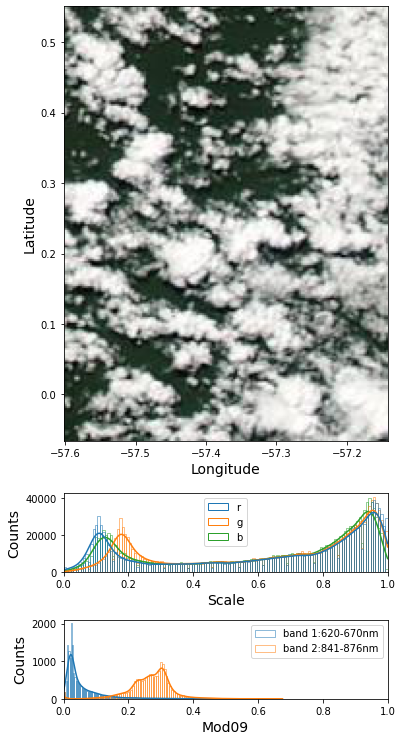

20150622_-63_-2
O2A band duration: 1.3410394442164236e-06  h


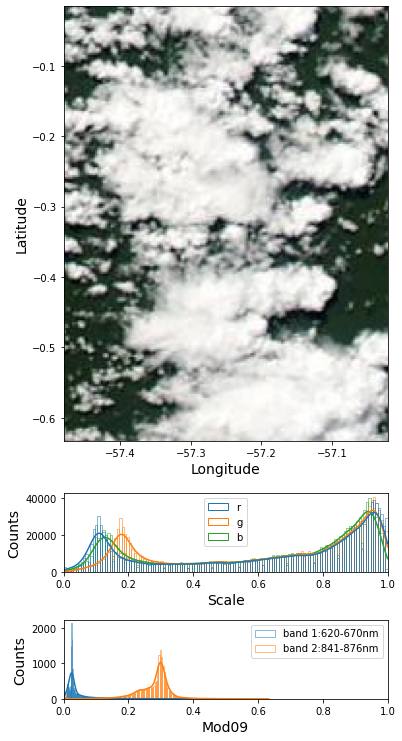

20150622_-120_-58
O2A band duration: 1.5450780564505193e-06  h


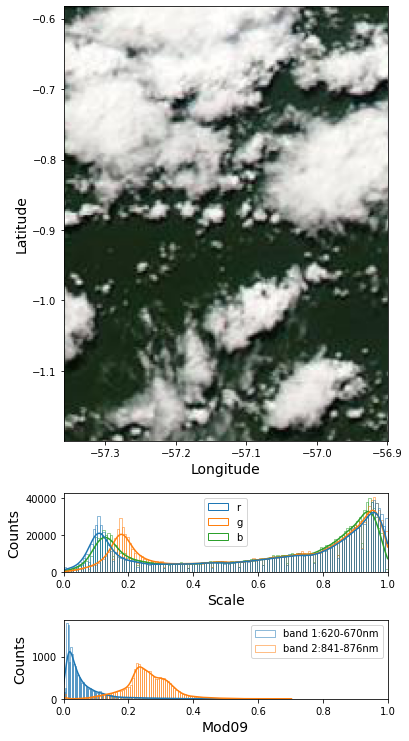

20150622_-177_-115
O2A band duration: 1.1592933313093251e-06  h


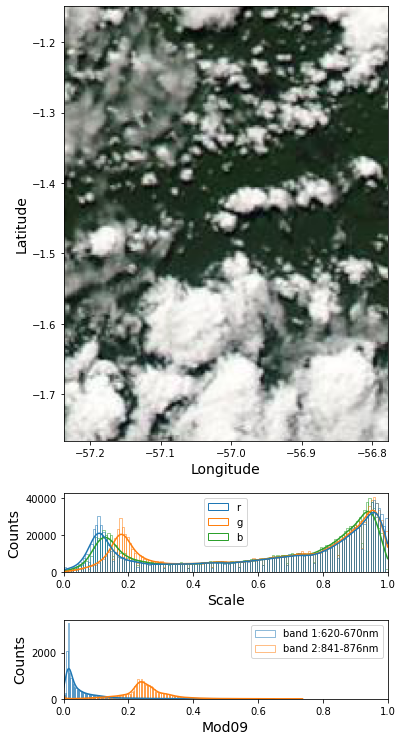

20150622_-233_-172
O2A band duration: 1.3047699920005268e-06  h


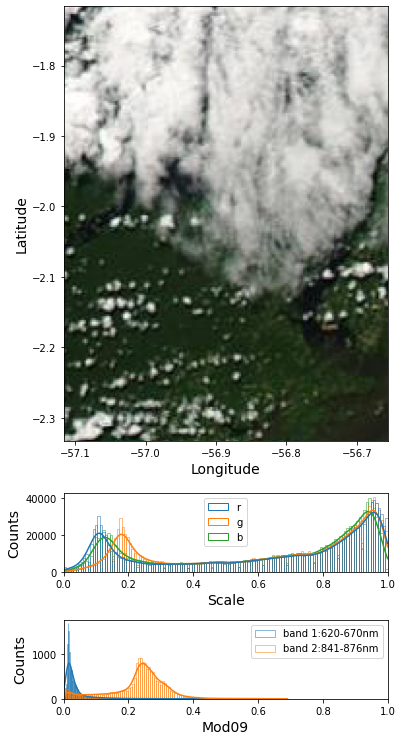

20150622_-290_-228
O2A band duration: 1.6243869322352112e-06  h


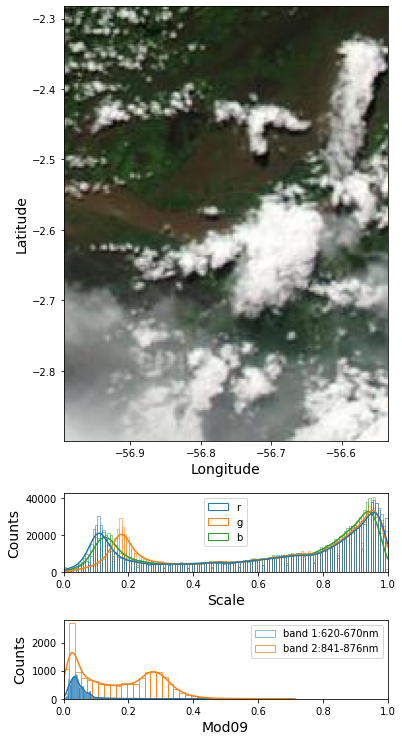

20150622_-347_-285
O2A band duration: 1.350074437343412e-06  h


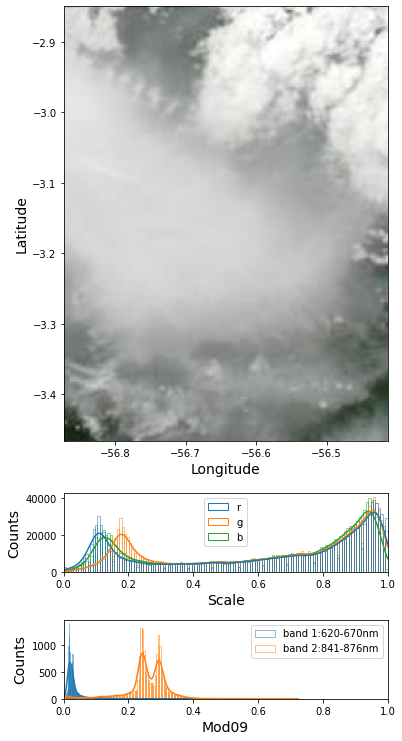

20150622_-403_-342
O2A band duration: 1.2639955578682322e-06  h


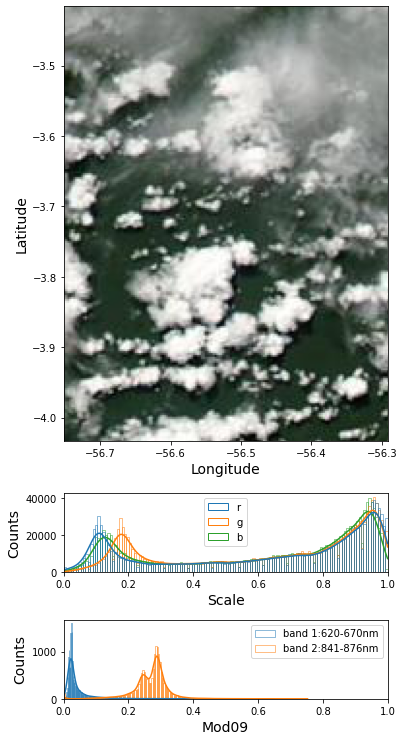

20150622_-460_-398
O2A band duration: 1.1954636041385432e-06  h


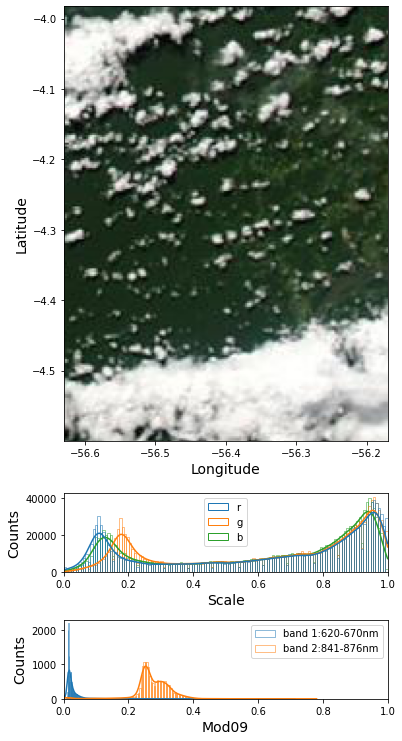

20150622_-517_-455
O2A band duration: 1.5398016936766605e-06  h


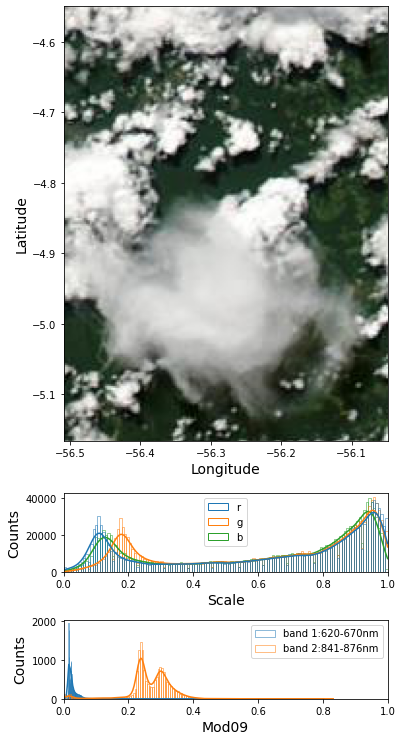

20150622_-573_-512
O2A band duration: 2.570508351911687e-06  h


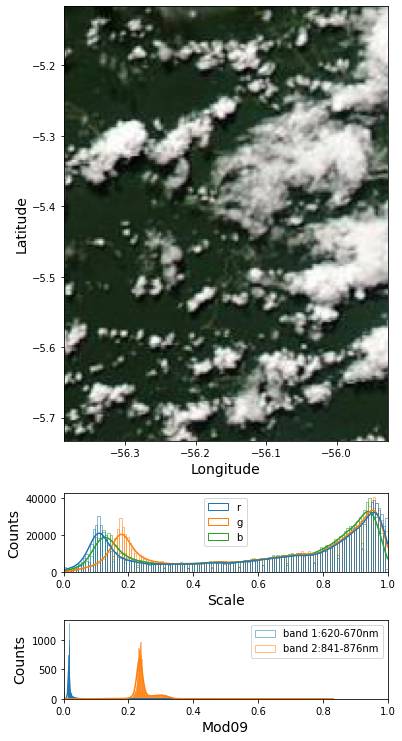

20150622_-630_-568
O2A band duration: 1.6882683525586294e-06  h


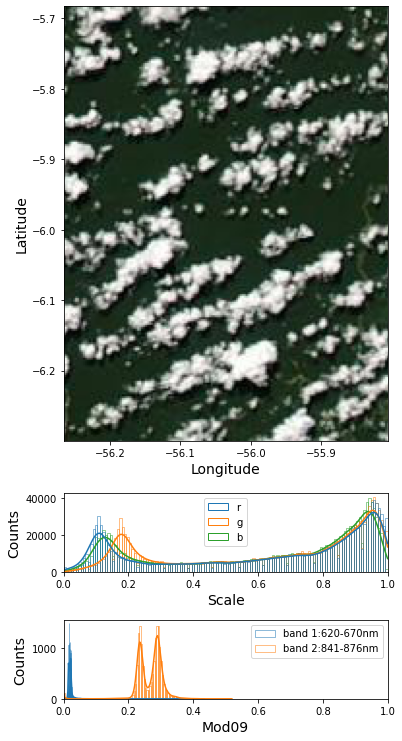

20150622_-687_-625
O2A band duration: 1.4603141850481431e-06  h


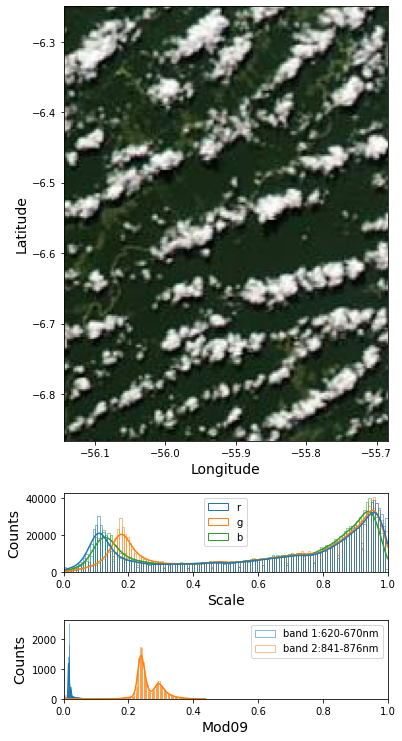

20150622_-743_-682
O2A band duration: 1.3547349954023956e-06  h


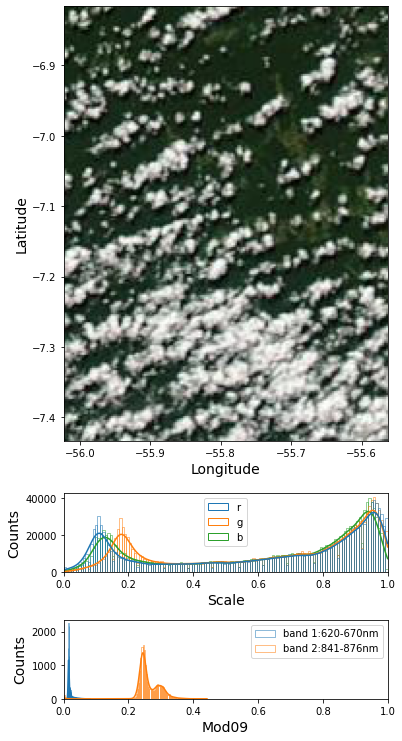

20150622_-800_-738
O2A band duration: 1.3221425211264027e-06  h


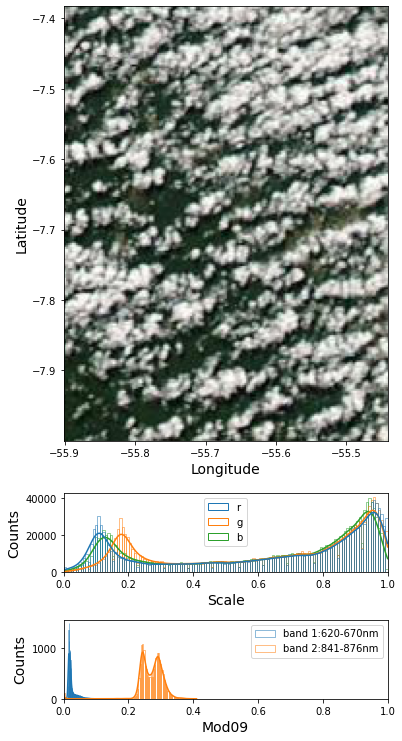

20150622_-857_-795
O2A band duration: 1.2274902676128678e-06  h


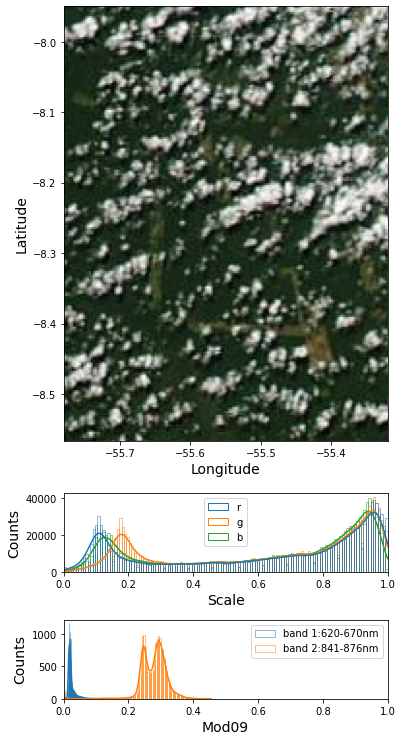

20150622_-913_-852
O2A band duration: 1.5541675060780513e-06  h


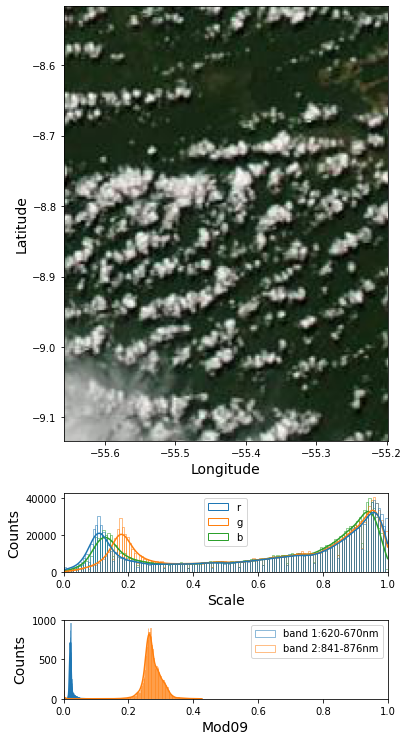

20150622_-970_-908
O2A band duration: 1.3497783220373094e-06  h


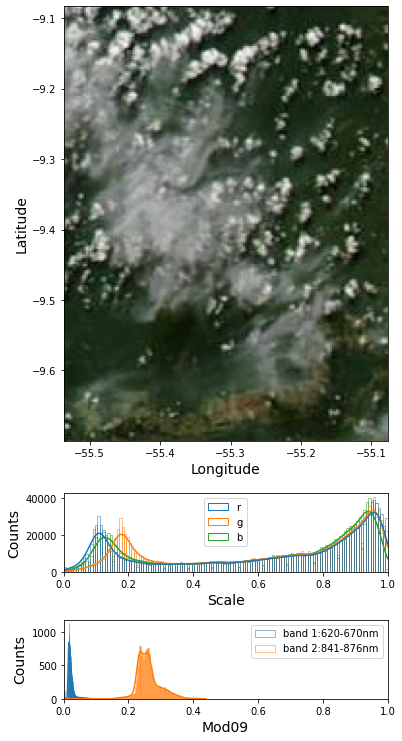

20150622_-1027_-965
O2A band duration: 1.2037385992395381e-06  h


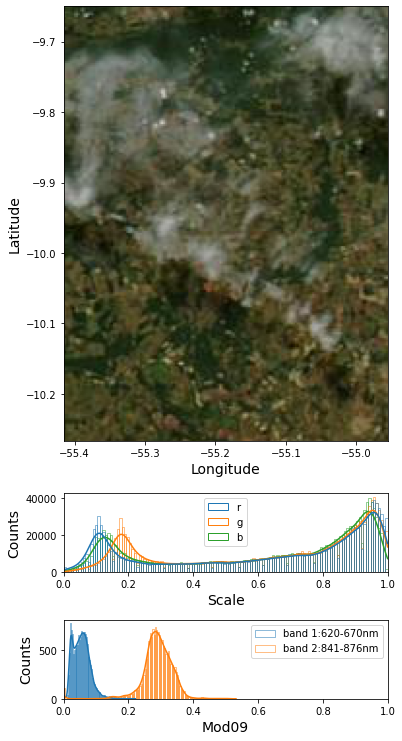

20150622_-1083_-1022
O2A band duration: 1.3947327776501577e-06  h


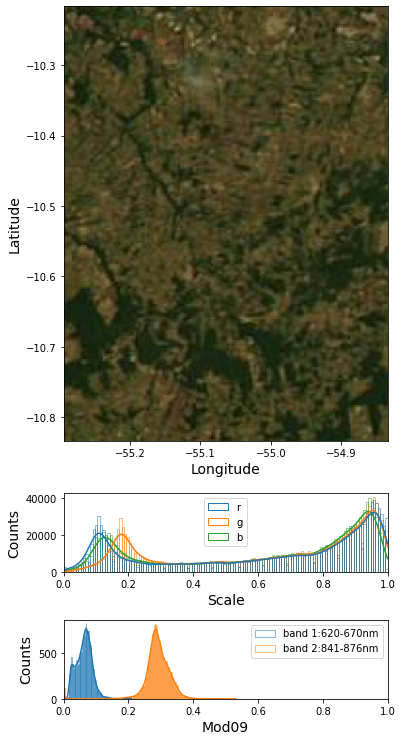

20150622_-1140_-1078
O2A band duration: 1.2543850203251674e-06  h


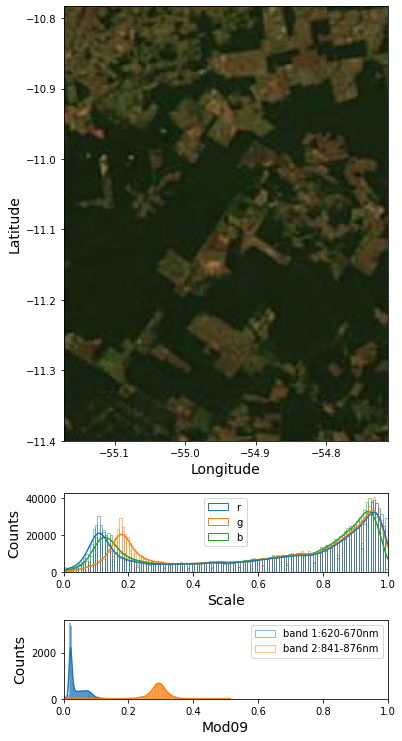

20150622_-1197_-1135
O2A band duration: 1.532004163083103e-06  h


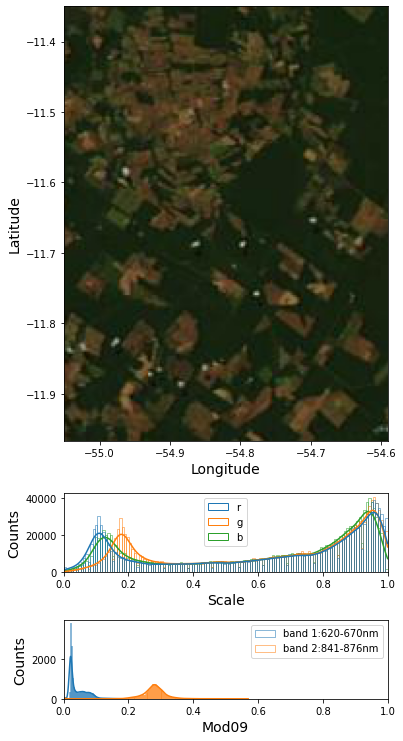

20150622_-1253_-1192
O2A band duration: 1.2384944582461483e-06  h


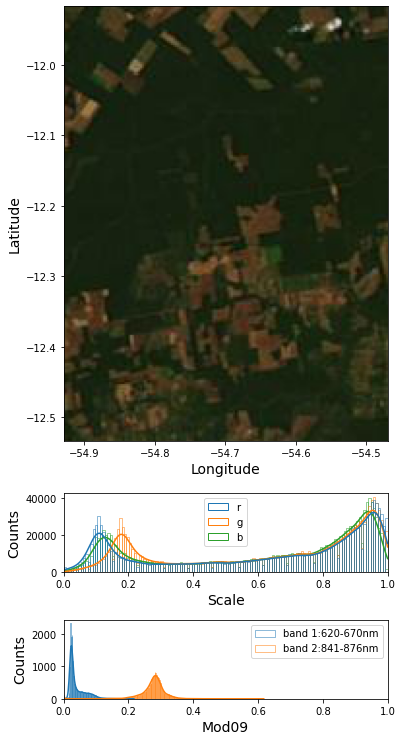

20150622_-1310_-1248
O2A band duration: 1.4378438936546446e-06  h


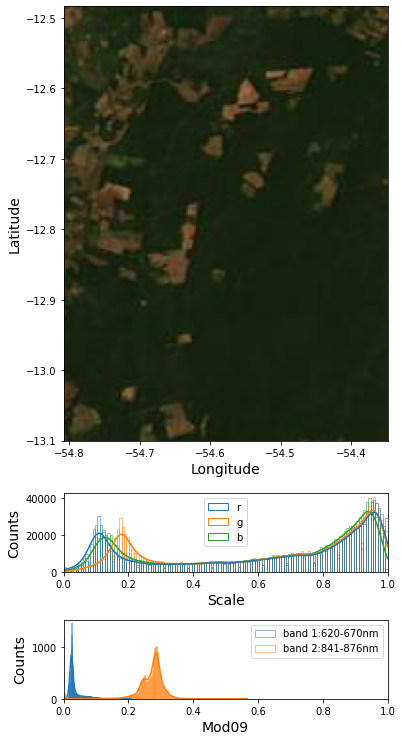

20150622_-1367_-1305
O2A band duration: 1.4276338818793495e-06  h


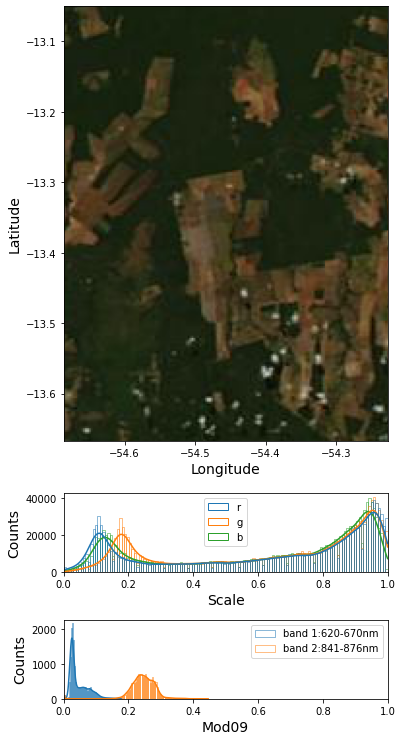

20150622_-1423_-1362
O2A band duration: 1.3679702856784894e-06  h


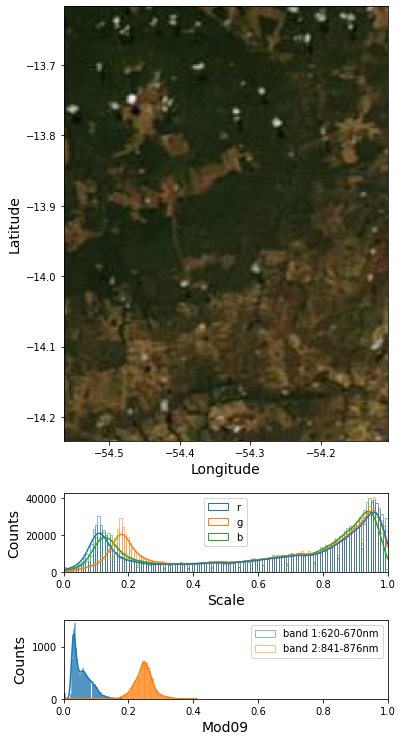

In [167]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)

    """
    fig = plt.figure(figsize=(5, 11))

    ax1 = fig.add_axes([0.05, 0.3, 0.9, 0.65])
    ax2 = fig.add_axes([0.05, 0.185, 0.9, 0.1])
    ax3 = fig.add_axes([0.05, 0.025, 0.9, 0.1])
    label_size = 14

    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    ax1.imshow(img,extent=sat.extent)
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]
    ax1.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax1.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax1.set_xlabel('Longitude', fontsize=label_size)
    ax1.set_ylabel('Latitude', fontsize=label_size)

    sns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2)
    ax2.set_xlabel('Scale', fontsize=label_size)
    ax2.set_ylabel('Counts', fontsize=label_size)
    ax2.set_xlim(0, 1)

    sns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm')
    sns.histplot(mod_sfc_alb_2d_band2.flatten(), kde=True, fill=False, ax=ax3, label='band 2:841-876nm')
    ax3.set_xlabel('Mod09', fontsize=label_size)
    ax3.set_ylabel('Counts', fontsize=label_size)
    ax3.legend()
    ax3.set_xlim(0, 1)
    plt.show()
    """

In [167]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
oco_alb_o2a, oco_alb_wco2, oco_alb_sco2 = [], [], []
mod09_alb_band1, mod09_alb_band2, mod09_alb_band3 = [], [], []
mod09_alb_band4, mod09_alb_band6, mod09_alb_band7 = [], [], []
for i in range(1):#len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][5, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][6, :], extent=sat.extent)

    vnames = [
            'BRDFResults/brdf_reflectance_o2',              # 0.77 microns
            'BRDFResults/brdf_reflectance_slope_o2',
            'BRDFResults/brdf_reflectance_strong_co2',      # 2.06 microns
            'BRDFResults/brdf_reflectance_slope_strong_co2',
            'BRDFResults/brdf_reflectance_weak_co2',        # 1.615 microns
            'BRDFResults/brdf_reflectance_slope_weak_co2'
              ]
    oco = oco2_std(fnames=sat.fnames['oco_std'], vnames=vnames, extent=sat.extent)

    oco_lon = oco.data['lon']['data']
    oco_lat = oco.data['lat']['data']
    logic = (oco_lon>=sat.extent[0]) & (oco_lon<=sat.extent[1]) & (oco_lat>=sat.extent[2]) & (oco_lat<=sat.extent[3])
    oco_lon = oco_lon[logic]
    oco_lat = oco_lat[logic]
    oco_sfc_alb_o2a = oco.data['brdf_reflectance_o2']['data']

    oco_sfc_alb_wco2 = oco.data['brdf_reflectance_weak_co2']['data']

    oco_sfc_alb_sco2 = oco.data['brdf_reflectance_strong_co2']['data']
    
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
    img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
    img_lon2d, img_lat2d = np.meshgrid(img_lon, img_lat)
        
    lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
    lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
    img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
    for i in range(len(lon_2d[:, 0])):
        for j in range(len(lat_2d[0, :])):
            index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
            index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
            index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
            index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))


    
    points = np.transpose(np.vstack((lon_2d.ravel(), lat_2d.ravel())))
    data_bkg_band1 = interpolate.griddata(points, mod_sfc_alb_2d_band1.ravel(),
                                          (oco_lon, oco_lat), method='nearest')
    data_bkg_band2 = interpolate.griddata(points, mod_sfc_alb_2d_band2.ravel(),
                                          (oco_lon, oco_lat), method='nearest')
    data_bkg_band3 = interpolate.griddata(points, mod_sfc_alb_2d_band3.ravel(),
                                          (oco_lon, oco_lat), method='nearest')
    data_bkg_band4 = interpolate.griddata(points, mod_sfc_alb_2d_band4.ravel(),
                                          (oco_lon, oco_lat), method='nearest')
    data_bkg_band6 = interpolate.griddata(points, mod_sfc_alb_2d_band6.ravel(),
                                          (oco_lon, oco_lat), method='nearest')
    data_bkg_band7 = interpolate.griddata(points, mod_sfc_alb_2d_band7.ravel(),
                                          (oco_lon, oco_lat), method='nearest')
    oco_alb_o2a.extend(oco_sfc_alb_o2a)
    oco_alb_wco2.extend(oco_sfc_alb_wco2)
    oco_alb_sco2.extend(oco_sfc_alb_sco2)
    
    mod09_alb_band1.extend(data_bkg_band1)
    mod09_alb_band2.extend(data_bkg_band2)
    mod09_alb_band3.extend(data_bkg_band3)
    mod09_alb_band4.extend(data_bkg_band4)
    mod09_alb_band6.extend(data_bkg_band6)
    mod09_alb_band7.extend(data_bkg_band7)
    

20150622_163_225
O2A band duration: 1.2931130549986848e-06  h


In [168]:
mod09_img = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
mod09_img[:, :, 0] = mod_sfc_alb_2d_band1.T
mod09_img[:, :, 1] = mod_sfc_alb_2d_band4.T
mod09_img[:, :, 2] = mod_sfc_alb_2d_band3.T

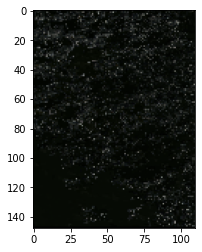

In [169]:
plt.imshow(mod09_img)

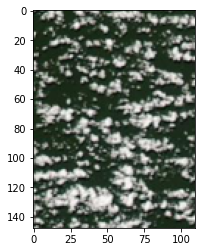

In [170]:
plt.imshow(img_reshape)

In [82]:
img = mpimg.imread(sat.fnames['mod_rgb'][0])
img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)

In [100]:
lon_2d[:, 0].shape

(110,)

In [89]:
mod_sfc_alb_2d_band1.shape

(110, 148)

In [ ]:
img[]

In [101]:
lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
for i in range(len(lon_2d[:, 0])):
    for j in range(len(lat_2d[0, :])):
        index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
        index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
        index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
        index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
        img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))

In [106]:
img_reshape[:,:,0].T.shape

(110, 148)

In [105]:
mod_sfc_alb_2d_band1.shape

(110, 148)

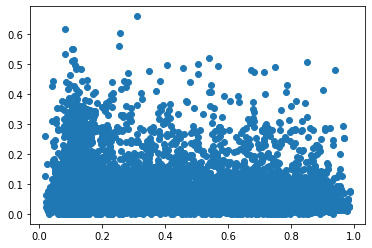

In [107]:
plt.scatter(img_reshape[:, :, 0].T.flatten(), mod_sfc_alb_2d_band1.flatten())
plt.show()

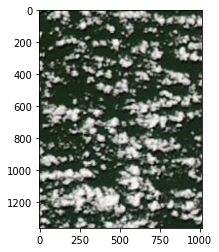

In [103]:
plt.imshow(img)

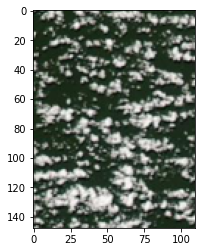

In [102]:
plt.imshow(img_reshape)

In [ ]:
index_lon = np.argmin(np.abs(OCO_class.lon2d[:, 0]-lon0))
                index_lat = np.argmin(np.abs(OCO_class.lat2d[0, :]-lat0))

In [ ]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)

    """
    fig = plt.figure(figsize=(5, 11))

    ax1 = fig.add_axes([0.05, 0.3, 0.9, 0.65])
    ax2 = fig.add_axes([0.05, 0.185, 0.9, 0.1])
    ax3 = fig.add_axes([0.05, 0.025, 0.9, 0.1])
    label_size = 14

    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    ax1.imshow(img,extent=sat.extent)
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]
    ax1.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax1.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax1.set_xlabel('Longitude', fontsize=label_size)
    ax1.set_ylabel('Latitude', fontsize=label_size)

    sns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2)
    ax2.set_xlabel('Scale', fontsize=label_size)
    ax2.set_ylabel('Counts', fontsize=label_size)
    ax2.set_xlim(0, 1)

    sns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm')
    sns.histplot(mod_sfc_alb_2d_band2.flatten(), kde=True, fill=False, ax=ax3, label='band 2:841-876nm')
    ax3.set_xlabel('Mod09', fontsize=label_size)
    ax3.set_ylabel('Counts', fontsize=label_size)
    ax3.legend()
    ax3.set_xlim(0, 1)
    plt.show()
    """

In [109]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][5, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][6, :], extent=sat.extent)

    
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
    img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
    img_lon2d, img_lat2d = np.meshgrid(img_lon, img_lat)
        
    lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
    lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
    img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
    for i in range(len(lon_2d[:, 0])):
        for j in range(len(lat_2d[0, :])):
            index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
            index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
            index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
            index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))
    img_r.extend(img_reshape[:, :, 0].T.flatten())
    img_g.extend(img_reshape[:, :, 1].T.flatten())
    img_b.extend(img_reshape[:, :, 2].T.flatten())
    
    mod09_band1.extend(mod_sfc_alb_2d_band1.flatten())
    mod09_band2.extend(mod_sfc_alb_2d_band2.flatten())
    mod09_band3.extend(mod_sfc_alb_2d_band3.flatten())
    mod09_band4.extend(mod_sfc_alb_2d_band4.flatten())
    mod09_band6.extend(mod_sfc_alb_2d_band6.flatten())
    mod09_band7.extend(mod_sfc_alb_2d_band7.flatten())
    

20150622_163_225
O2A band duration: 1.1098022226481892e-06  h
20150622_107_168
O2A band duration: 1.4798897225571433e-06  h
20150622_50_112
O2A band duration: 1.5272072222513898e-06  h
20150622_-7_55
O2A band duration: 1.2831969444151683e-06  h
20150622_-63_-2
O2A band duration: 1.540063333070268e-06  h
20150622_-120_-58
O2A band duration: 1.4238119441264037e-06  h
20150622_-177_-115
O2A band duration: 2.187008610942737e-06  h
20150622_-233_-172
O2A band duration: 1.1131469444889161e-06  h
20150622_-290_-228
O2A band duration: 1.2507869440822914e-06  h
20150622_-347_-285
O2A band duration: 1.2505138890143524e-06  h
20150622_-403_-342
O2A band duration: 1.3042330556345404e-06  h
20150622_-460_-398
O2A band duration: 1.2411027778903696e-06  h
20150622_-517_-455
O2A band duration: 1.2206030553190633e-06  h
20150622_-573_-512
O2A band duration: 1.3092536108969297e-06  h
20150622_-630_-568
O2A band duration: 1.3279794443911266e-06  h
20150622_-687_-625
O2A band duration: 1.3818105556614077e

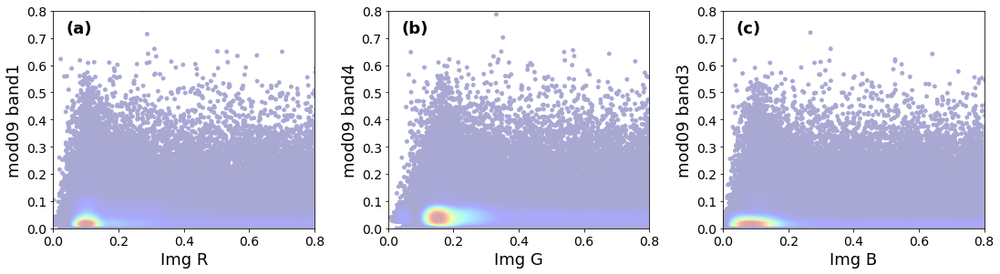

In [117]:
fig, (ax11, ax12, ax13) = plt.subplots(1, 3, figsize=(16, 5), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax13]
label_size = 18
tick_size = 14
xy_list = [(img_r, mod09_band1), (img_g, mod09_band4),
           (img_b, mod09_band3)]
xy_list_label = [('Img R', 'mod09 band1'), ('Img G', 'mod09 band4'),
           ('Img B', 'mod09 band3')]
for i in range(3):
    ax = ax_list[i]

    x = np.array(xy_list[i][0])
    y = np.array(xy_list[i][1])
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    
    # plot figure
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    x_array = np.array([np.min(x), np.max(x)])
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_xlabel(xy_list_label[i][0], fontsize=label_size)
    ax.set_ylabel(xy_list_label[i][1], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = 0, 0.8
    ymin, ymax = 0, 0.8
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    #ax.plot([0,1], [0,1], 'r')
plt.show()

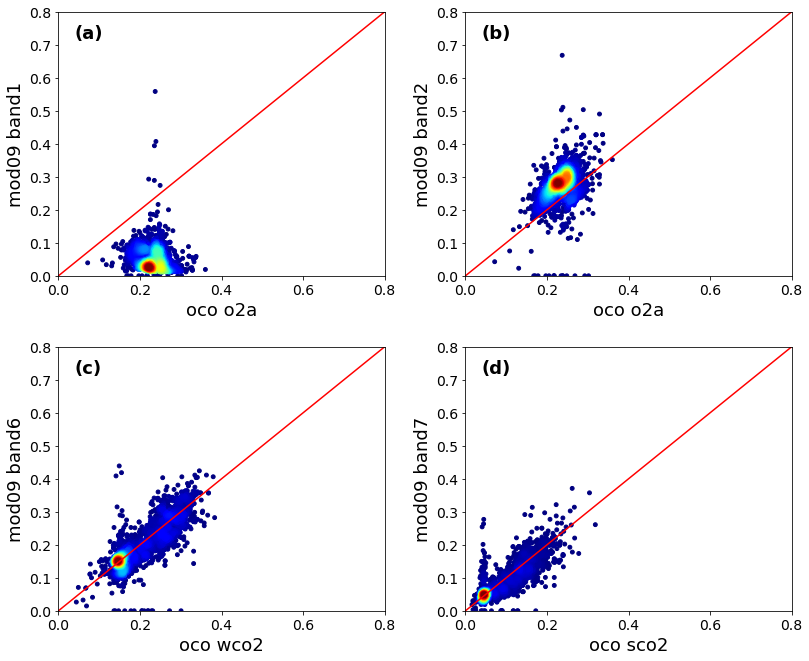

In [183]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2, 2, figsize=(12, 10), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
xy_list = [(oco_alb_o2a, mod09_alb_band1), (oco_alb_o2a, mod09_alb_band2),
           (oco_alb_wco2, mod09_alb_band6), (oco_alb_sco2, mod09_alb_band7)]
xy_list_label = [('oco o2a', 'mod09 band1'), ('oco o2a', 'mod09 band2'),
           ('oco wco2', 'mod09 band6'), ('oco sco2', 'mod09 band7')]
for i in range(4):
    ax = ax_list[i]

    x = np.array(xy_list[i][0])
    y = np.array(xy_list[i][1])
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    
    # plot figure
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    x_array = np.array([np.min(x), np.max(x)])
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_xlabel(xy_list_label[i][0], fontsize=label_size)
    ax.set_ylabel(xy_list_label[i][1], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = 0, 0.8
    ymin, ymax = 0, 0.8
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    ax.plot([0,1], [0,1], 'r')
plt.show()

In [6]:
sat

In [7]:

# band 1: 620  - 670  nm, index 0
# band 2: 841  - 876  nm, index 1
# band 3: 459  - 479  nm, index 2
# band 4: 545  - 565  nm, index 3
# band 5: 1230 - 1250 nm, index 4
# band 6: 1628 - 1652 nm, index 5
# band 7: 2105 - 2155 nm, index 6

#R = 0.66 μm
#G = 0.55 μm
#B = 0.47 μm


In [248]:
def pre_cld_oco_rgb(sat, mode='rgb', cth=None, scale_factor=1.0, solver='3D'):

    # retrieve 1. cloud top height; 2. sensor zenith; 3. sensor azimuth for MODIS L1B (250nm) data from MODIS L2 (5km resolution)
    # ===================================================================================
    modl2      = modis_l2(fnames=sat.fnames['mod_l2'], extent=sat.extent, vnames=['Sensor_Zenith', 'Sensor_Azimuth', 'Cloud_Top_Height'])
    logic_cth  = (modl2.data['cloud_top_height']['data']>0.0)
    lon0       = modl2.data['lon_5km']['data']
    lat0       = modl2.data['lat_5km']['data']
    cth0       = modl2.data['cloud_top_height']['data']/1000.0 # units: km

    mod03      = modis_03(fnames=sat.fnames['mod_03'], extent=sat.extent, vnames=['Height'])
    logic_sfh  = (mod03.data['height']['data']>0.0)
    lon1       = mod03.data['lon']['data']
    lat1       = mod03.data['lat']['data']
    sfh1       = mod03.data['height']['data']/1000.0 # units: km
    sza1       = mod03.data['sza']['data']
    saa1       = mod03.data['saa']['data']
    vza1       = mod03.data['vza']['data']
    vaa1       = mod03.data['vaa']['data']

    modl1b = modis_l1b(fnames=sat.fnames['mod_02'], extent=sat.extent)
    lon_2d, lat_2d, ref_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent)
    lon_2d, lat_2d, rad_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent)

    a0         = np.median(ref_2d)
    mu0        = np.cos(np.deg2rad(sza1.mean()))

    xx_2stream = np.linspace(0.0, 200.0, 10000)
    yy_2stream = cal_r_twostream(xx_2stream, a=a0, mu=mu0)

    # =============================================================================
    if mode == 'rgb':
        mod_rgb = mpl_img.imread(sat.fnames['mod_rgb'][0])

        lon_rgb0 = np.linspace(sat.extent[0], sat.extent[1], mod_rgb.shape[1]+1)
        lat_rgb0 = np.linspace(sat.extent[2], sat.extent[3], mod_rgb.shape[0]+1)
        lon_rgb = (lon_rgb0[1:]+lon_rgb0[:-1])/2.0
        lat_rgb = (lat_rgb0[1:]+lat_rgb0[:-1])/2.0

        mod_r = mod_rgb[:, :, 0]
        mod_g = mod_rgb[:, :, 1]
        mod_b = mod_rgb[:, :, 2]

        logic_rgb_nan0 = (mod_r<=(np.median(mod_r)*1.06)) |\
                        (mod_g<=(np.median(mod_g)*1.06)) |\
                        (mod_b<=(np.median(mod_b)*1.06))
        logic_rgb_nan = np.flipud(logic_rgb_nan0).T

        x0_rgb = lon_rgb[0]
        y0_rgb = lat_rgb[0]
        dx_rgb = lon_rgb[1] - x0_rgb
        dy_rgb = lat_rgb[1] - y0_rgb

        indices_x = np.int_(np.round((lon_2d-x0_rgb)/dx_rgb, decimals=0))
        indices_y = np.int_(np.round((lat_2d-y0_rgb)/dy_rgb, decimals=0))

        logic_ref_nan = logic_rgb_nan[indices_x, indices_y]

        indices    = np.where(logic_ref_nan!=1)
        indices_x  = indices[0]
        indices_y  = indices[1]
        lon        = lon_2d[indices_x, indices_y]
        lat        = lat_2d[indices_x, indices_y]
         

    elif mode == 'ori':
        threshold  = a0 * 2.0 # needs to be improved
        indices    = np.where(ref_2d>threshold)
        indices_x  = indices[0]
        indices_y  = indices[1]
        lon        = lon_2d[indices_x, indices_y]
        lat        = lat_2d[indices_x, indices_y]
    return lon, lat

In [260]:
same_list = []
only_rgb = []
only_ori = []
for i in range(len(rgb)):
    if rgb[i] in ori:
        same_list.append(rgb[i])
    else:
        only_rgb.append(rgb[i])
for i in range(len(ori)):
    if ori[i] not in same_list:
        only_ori.append(rgb[i])

In [261]:
print(len(same_list), len(only_rgb), len(only_ori))

16918 7012 143


In [50]:
img = mpimg.imread(sat.fnames['mod_rgb'][0])
rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                        columns=['r', 'g', 'b'])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
rgb_array['b/g'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])

/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in true_divide
  
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  
/Users/stev

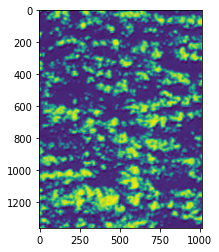

In [10]:
plt.imshow(img[:, :, 0])
plt.show()

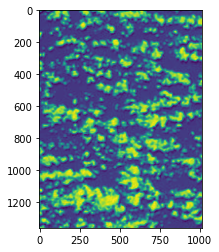

In [11]:
plt.imshow(img[:, :, 1])
plt.show()

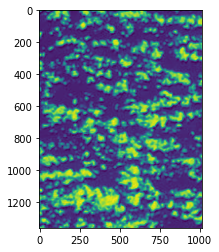

In [12]:
plt.imshow(img[:, :, 2])
plt.show()

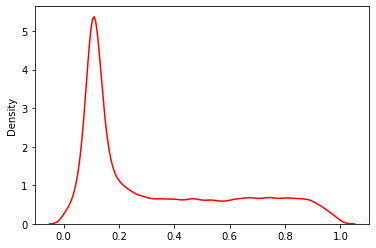

In [73]:
sns.kdeplot(img[:, :, 0].flatten(), color='r',
             label='r')#, color='lightcoral', label='qf=0')
plt.show()

In [76]:
img.shape

(1359, 1013, 4)

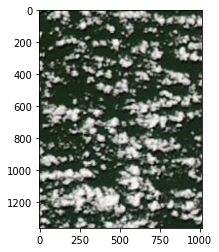

In [78]:
plt.imshow(img)

In [81]:
img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
print(sat.extent[:2])
img_lon

[-57.9668, -57.5068]


array([-57.9668    , -57.96634545, -57.96589091, ..., -57.50770909,
       -57.50725455, -57.5068    ])

/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:53: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:53: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:76: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:76: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:77: RuntimeWarni

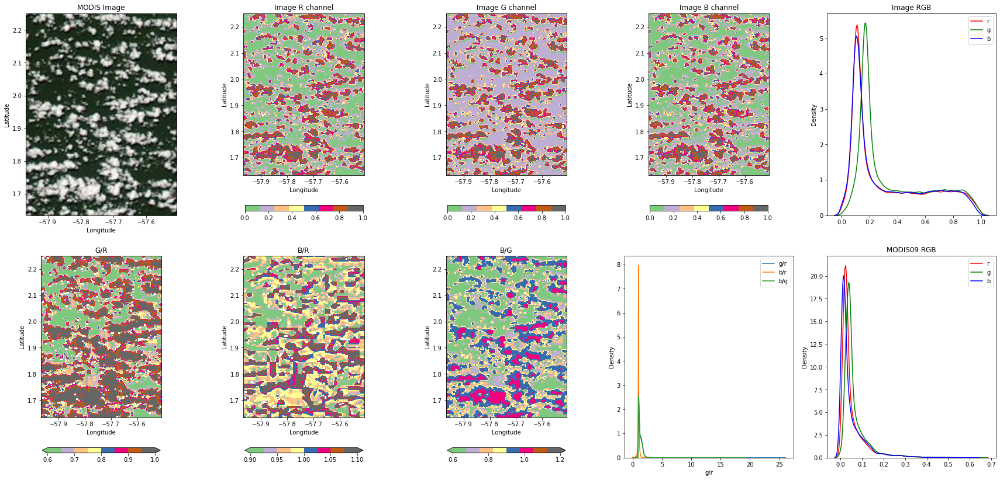

In [171]:
f, ((ax11, ax12, ax13, ax14, ax15),
    (ax21, ax22, ax23, ax24, ax25)) =plt.subplots(2, 5, figsize=(30, 14))

wesn= sat.extent#png[1]
img = mpimg.imread(sat.fnames['mod_rgb'][0])
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]


ax11.imshow(img,extent=wesn)
ax11.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax11.set_ylim(np.min(lat_dom), np.max(lat_dom))
ax11.set_xlabel('Longitude')
ax11.set_ylabel('Latitude')
ax11.set_title('MODIS Image')

cmap = 'Accent'
cbar_karg = {'location':'bottom', 'fraction':0.05, 'shrink':0.7}
im12 = ax12.imshow(img[:, :, 0], extent=wesn, cmap=cmap)
ax12.set_xlabel('Longitude')
ax12.set_ylabel('Latitude')
ax12.set_title('Image R channel')
f.colorbar(im12, ax=ax12, **cbar_karg)

im13 = ax13.imshow(img[:, :, 1], extent=wesn, cmap=cmap)
ax13.set_xlabel('Longitude')
ax13.set_ylabel('Latitude')
ax13.set_title('Image G channel')
f.colorbar(im13, ax=ax13, **cbar_karg)

im14 = ax14.imshow(img[:, :, 2], extent=wesn, cmap=cmap)
ax14.set_xlabel('Longitude')
ax14.set_ylabel('Latitude')
ax14.set_title('Image B channel')
f.colorbar(im14, ax=ax14, **cbar_karg)

sns.kdeplot(img[:, :, 0].flatten(), ax=ax15, color='r', label='r')
sns.kdeplot(img[:, :, 1].flatten(), ax=ax15, color='g', label='g')
sns.kdeplot(img[:, :, 2].flatten(), ax=ax15, color='b', label='b')
ax15.legend()
ax15.set_title('Image RGB')

array21 = img[:, :, 2]/img[:, :, 1]
array21[img[:, :, 0]==0] = np.nan
threshold21 = 1
array21[array21>threshold21] = threshold21
im21 = ax21.imshow(array21, extent=wesn, cmap=cmap, vmin=0.6)
ax21.set_xlabel('Longitude')
ax21.set_ylabel('Latitude')
ax21.set_title('G/R')
f.colorbar(im21, ax=ax21, extend='both', **cbar_karg)

array22 = img[:, :, 2]/img[:, :, 0]
array22[img[:, :, 0]==0] = np.nan
threshold22 = 1.1
array22[array22>threshold22] = threshold22
im22 = ax22.imshow(array22, extent=wesn, cmap=cmap, vmin=0.9)
ax22.set_xlabel('Longitude')
ax22.set_ylabel('Latitude')
ax22.set_title('B/R')
f.colorbar(im22, ax=ax22, extend='both', **cbar_karg)

array23 = img[:, :, 2]/img[:, :, 1]
array23[img[:, :, 1]==0] = np.nan
threshold23 = 1.2
array23[array23>threshold23] = threshold23
im23 = ax23.imshow(array23, extent=wesn, cmap=cmap, vmin=0.6)
ax23.set_xlabel('Longitude')
ax23.set_ylabel('Latitude')
ax23.set_title('B/G')
f.colorbar(im23, ax=ax23, extend='both', **cbar_karg)


rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                        columns=['r', 'g', 'b'])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
rgb_array['b/g'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])

sns.kdeplot(rgb_array['g/r'], ax=ax24, label='g/r')
sns.kdeplot(rgb_array['b/r'], ax=ax24, label='b/r')
sns.kdeplot(rgb_array['b/g'], ax=ax24, label='b/g')
ax24.legend()
#ax24.set_xlim(0.4, 2.4)

sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax25, color='r', label='r')
sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax25, color='g', label='g')
sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax25, color='b', label='b')
ax25.legend()
ax25.set_title('MODIS09 RGB')

plt.show()

20150622_163_225
O2A band duration: 1.1506580570615673e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

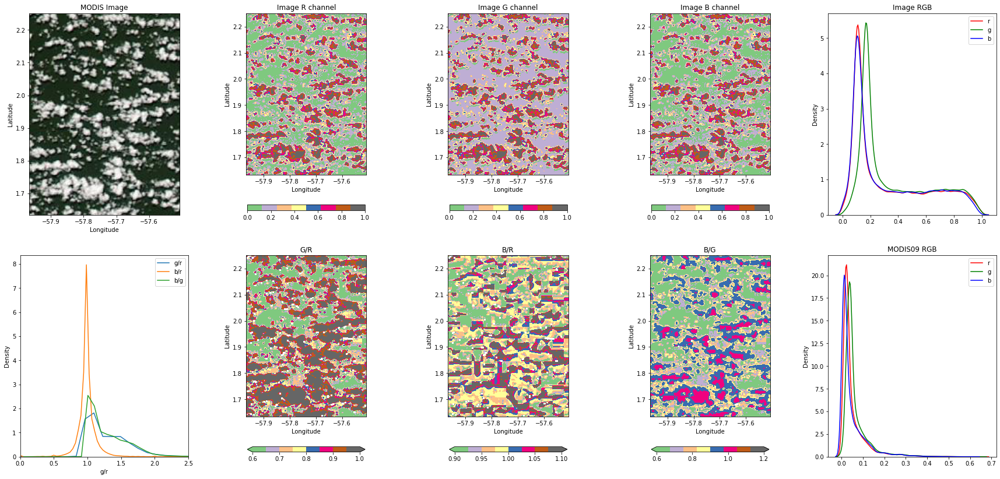

20150622_107_168
O2A band duration: 1.271831388294231e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

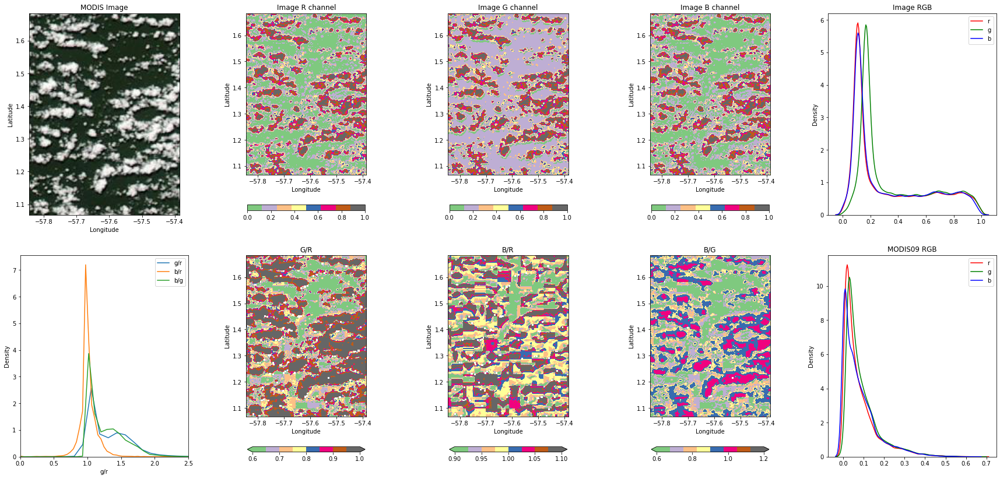

20150622_50_112
O2A band duration: 1.2533986106670151e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

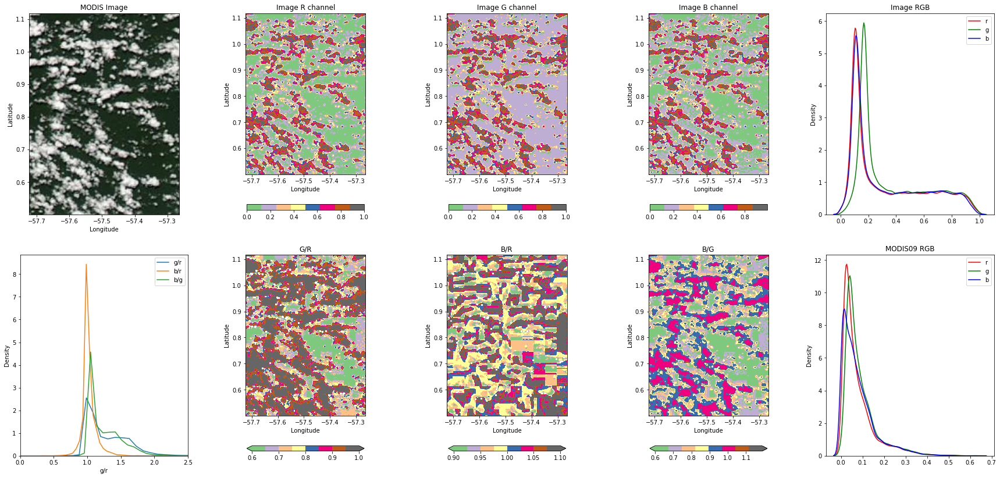

20150622_-7_55
O2A band duration: 1.3095811118546407e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

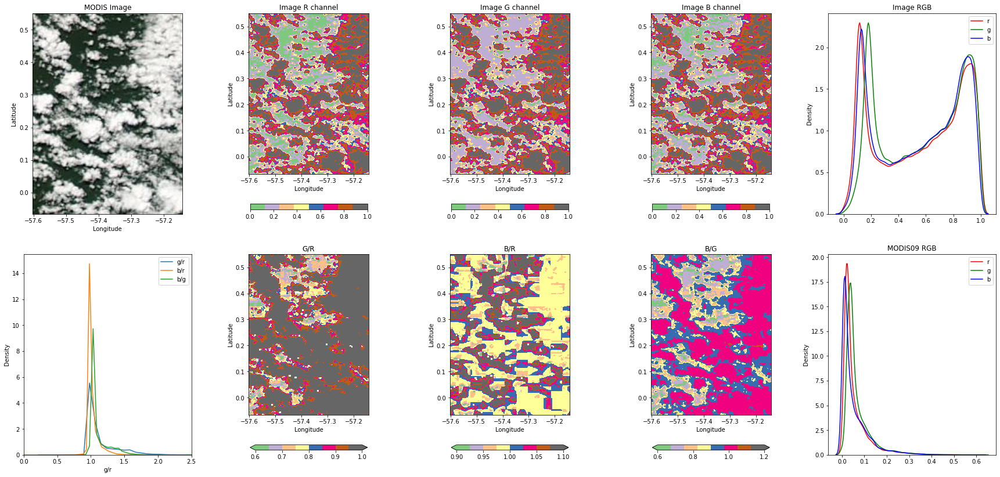

20150622_-63_-2
O2A band duration: 1.2219416668004771e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

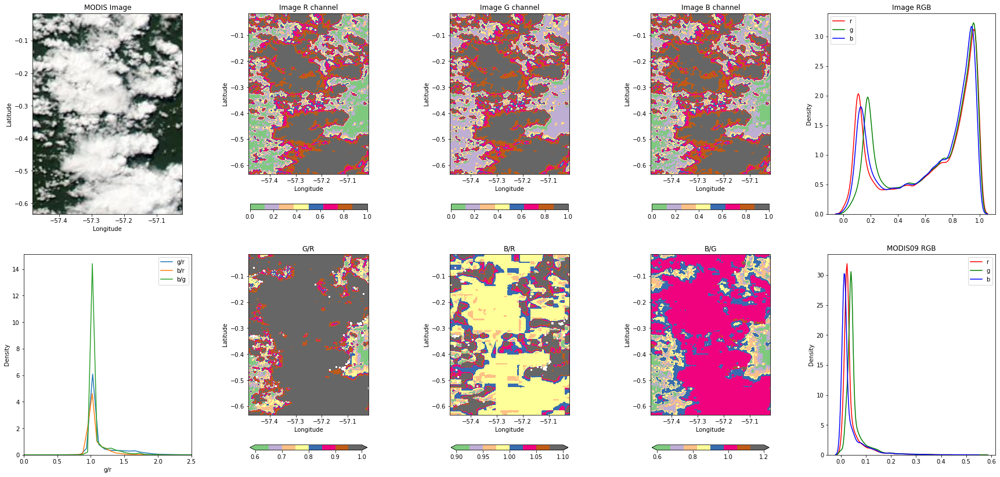

20150622_-120_-58
O2A band duration: 1.235107776867355e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

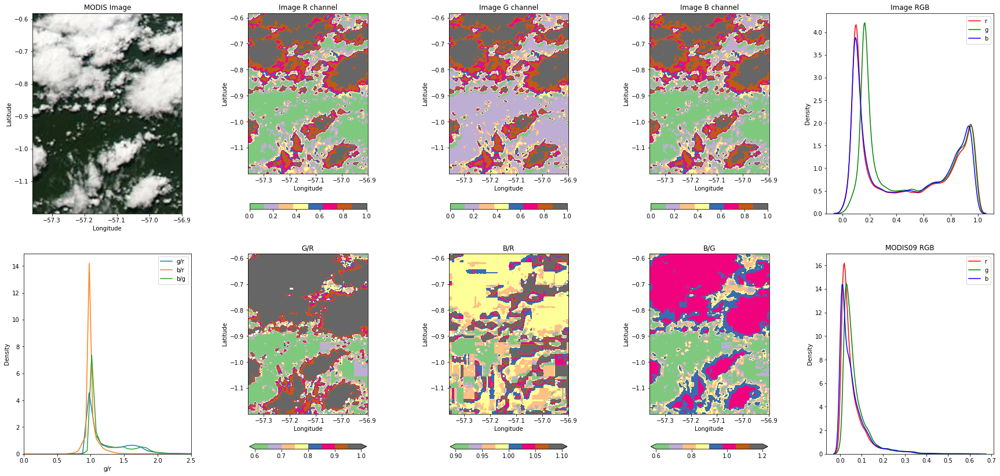

20150622_-177_-115
O2A band duration: 1.2485922222064498e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

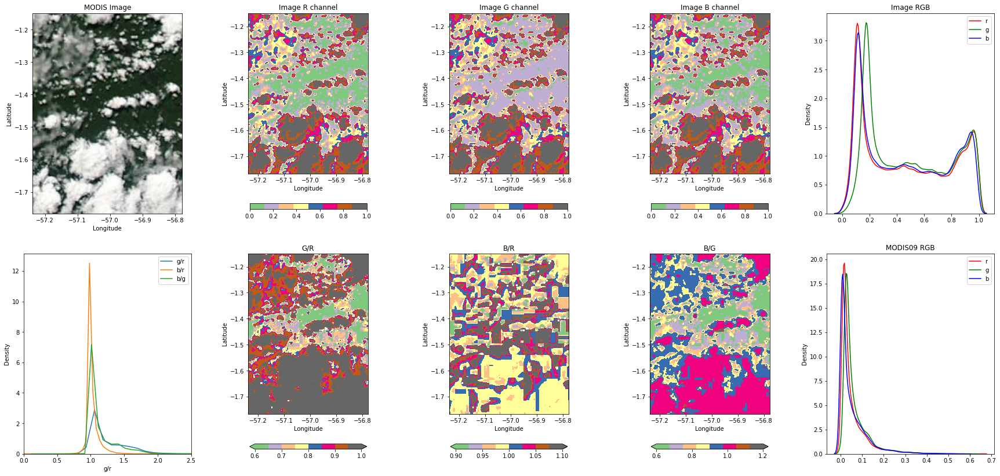

20150622_-233_-172
O2A band duration: 1.119296110927179e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

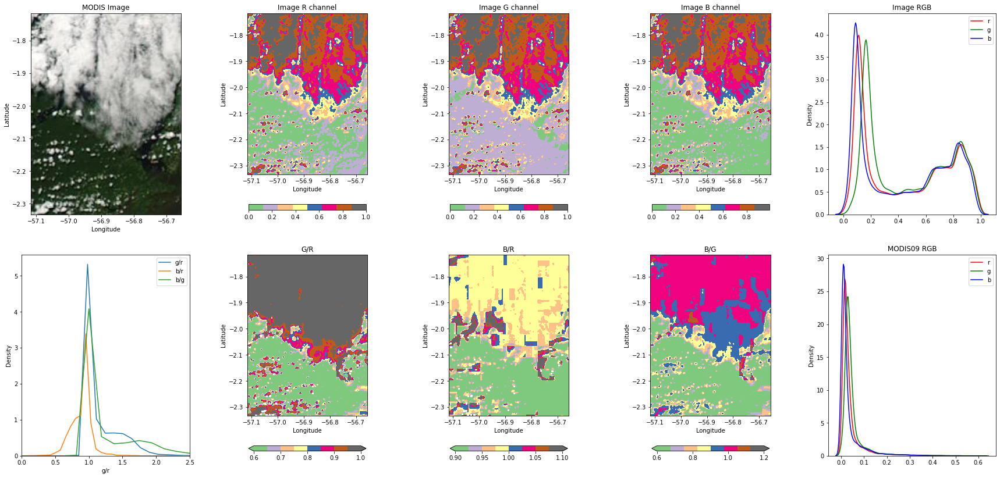

20150622_-290_-228
O2A band duration: 1.4079769445945406e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeW

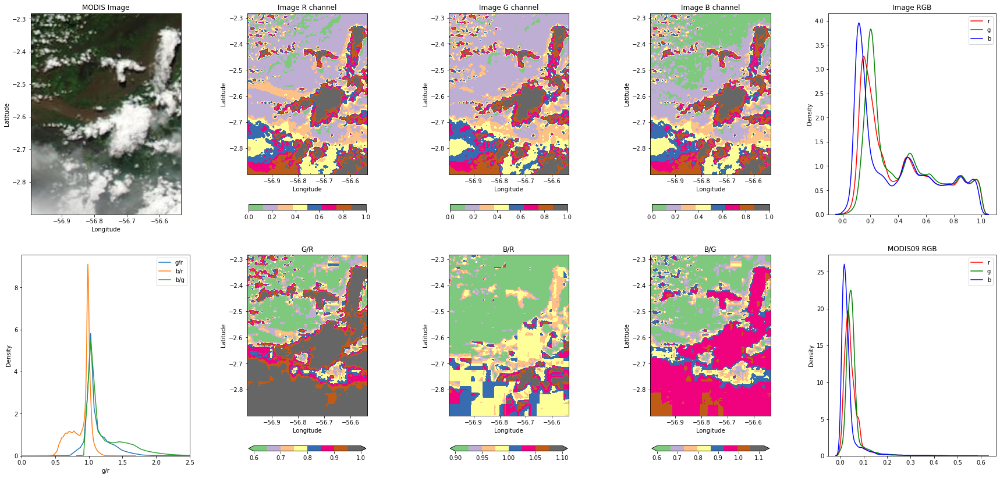

20150622_-347_-285
O2A band duration: 1.5528308318203522e-06  h


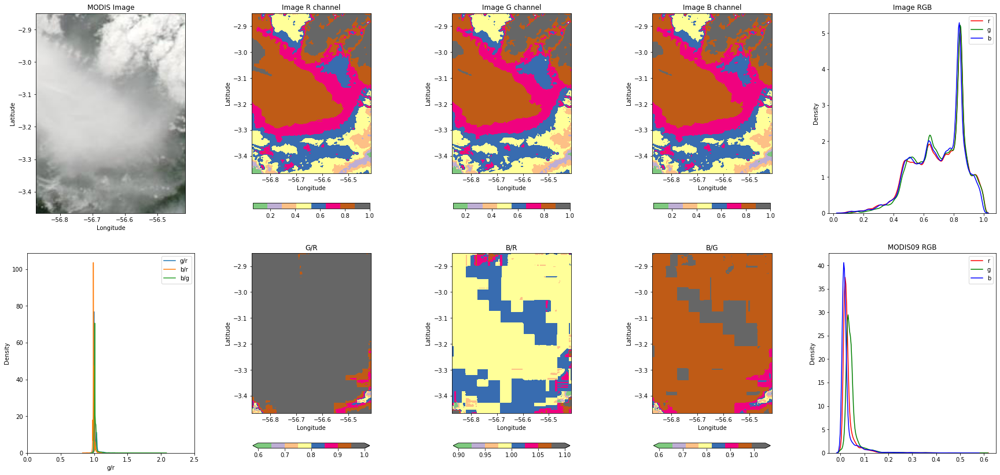

20150622_-403_-342
O2A band duration: 1.3075747220783442e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

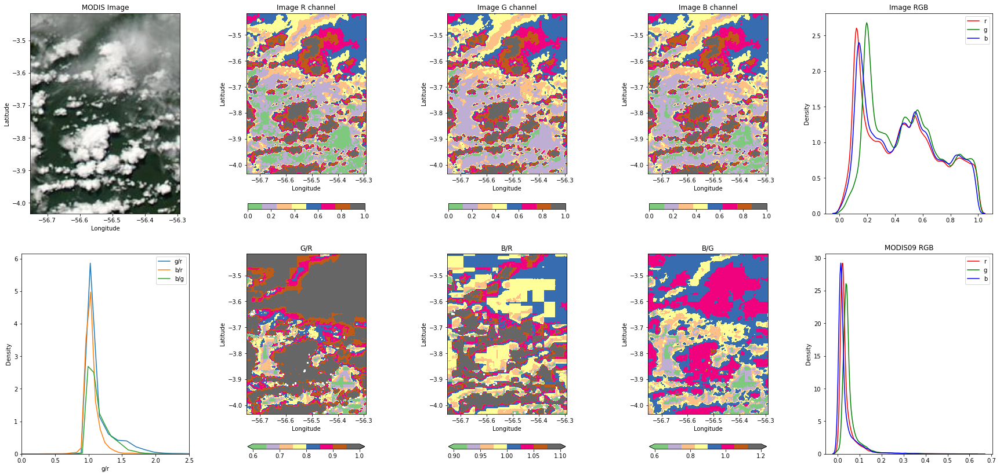

20150622_-460_-398
O2A band duration: 1.1834911108760732e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

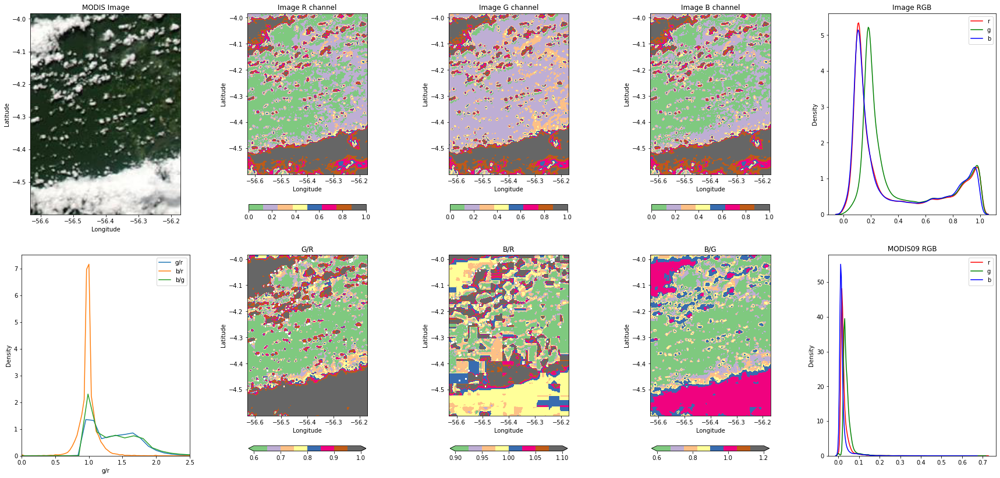

20150622_-517_-455
O2A band duration: 1.3109138894328174e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

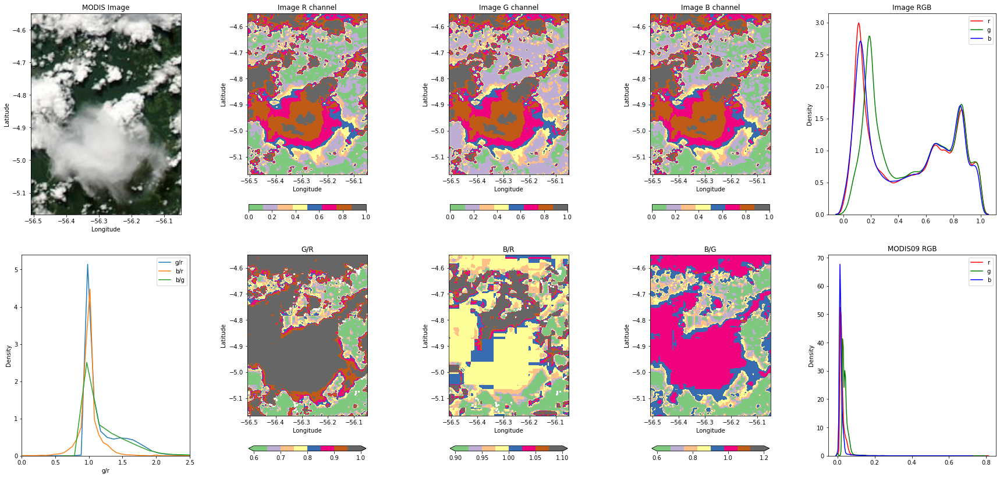

20150622_-573_-512
O2A band duration: 1.4198222217803253e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

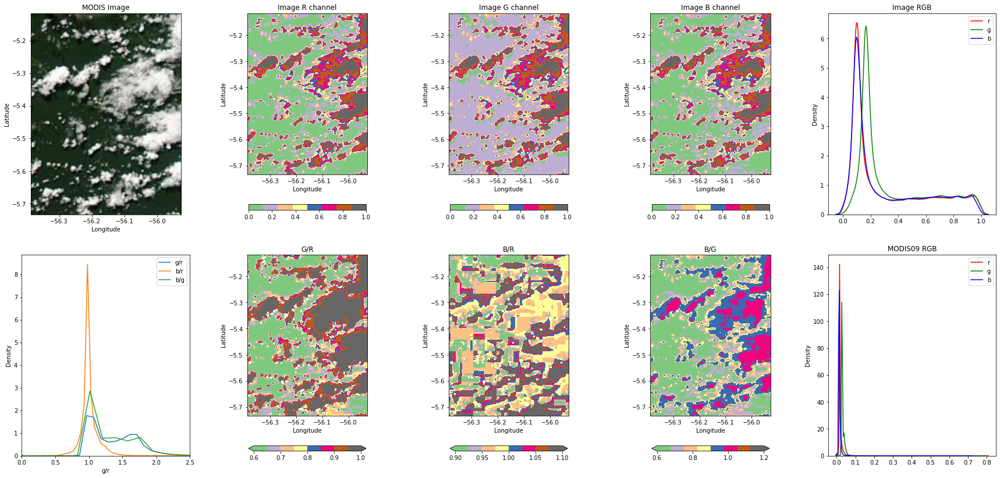

20150622_-630_-568
O2A band duration: 1.261882221620504e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

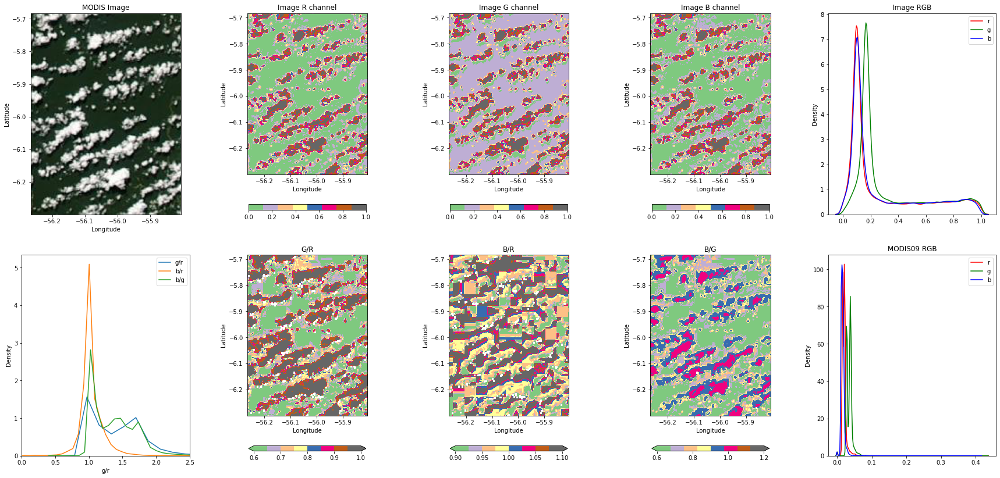

20150622_-687_-625
O2A band duration: 1.5589361121076055e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

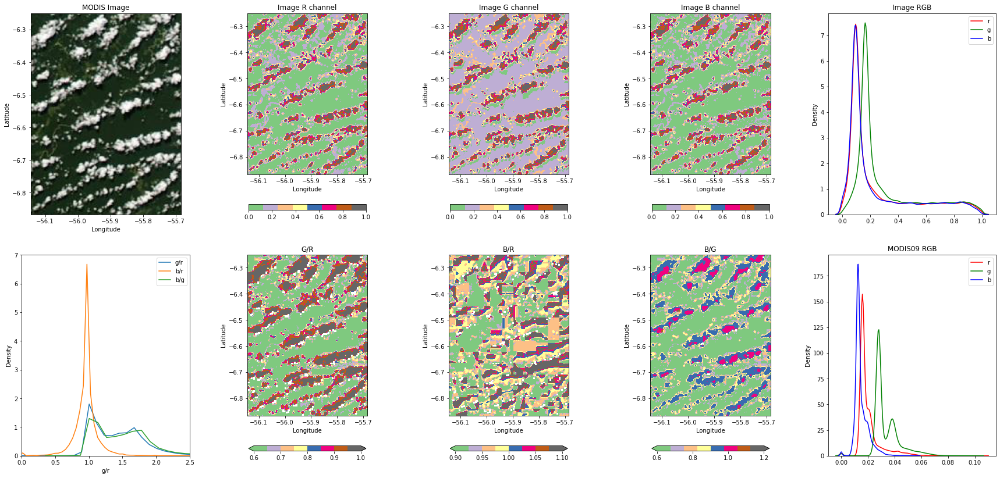

20150622_-743_-682
O2A band duration: 1.8799208333398888e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

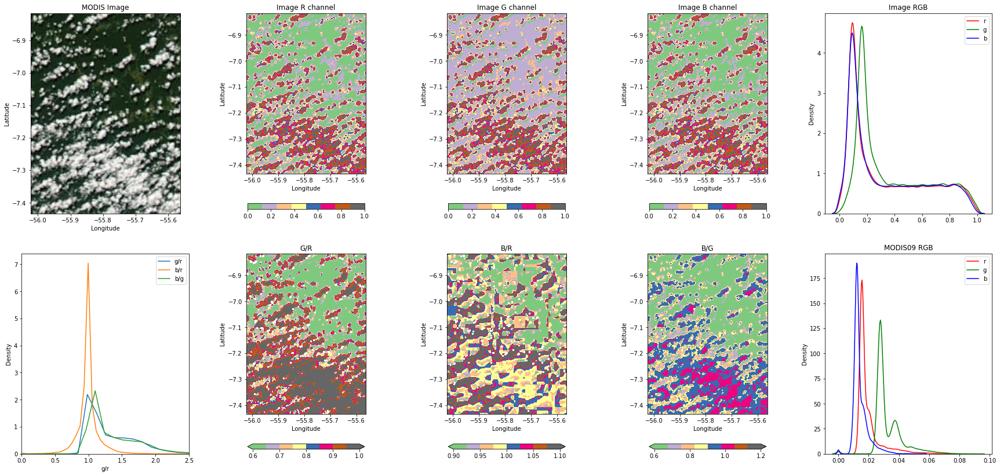

20150622_-800_-738
O2A band duration: 1.7894083329237118e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

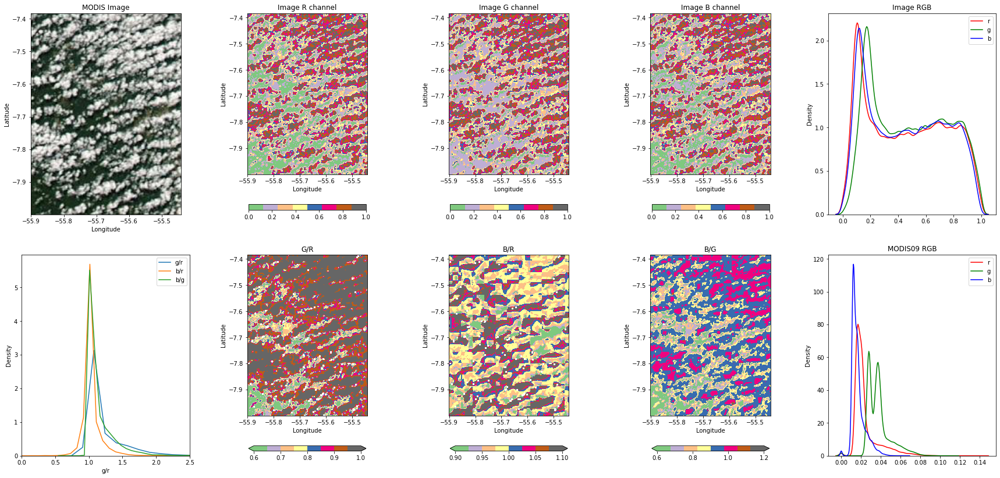

20150622_-857_-795
O2A band duration: 1.4114494438722936e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

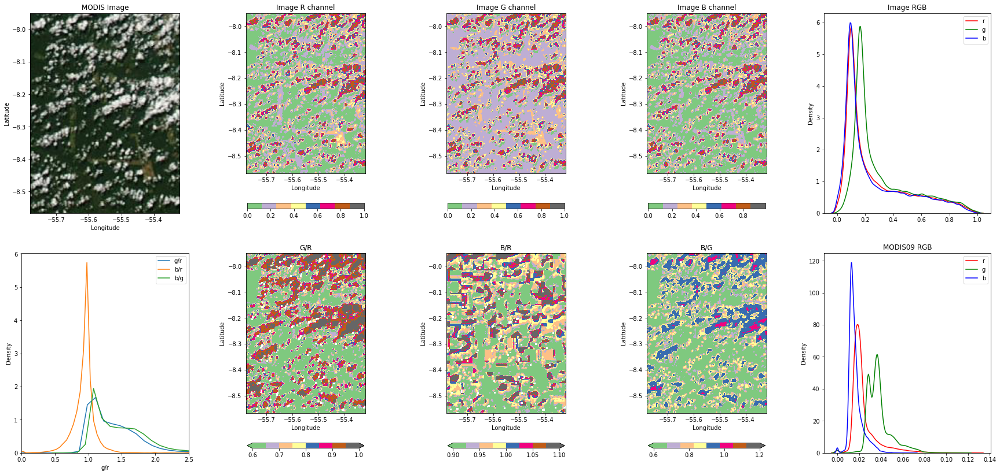

20150622_-913_-852
O2A band duration: 1.7074416670463202e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

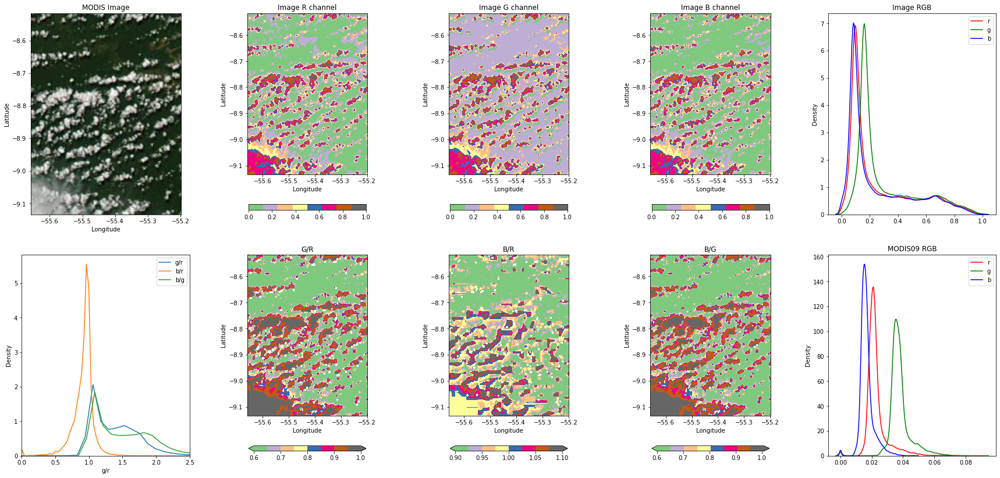

20150622_-970_-908
O2A band duration: 1.2526849988919114e-06  h


KeyboardInterrupt: 

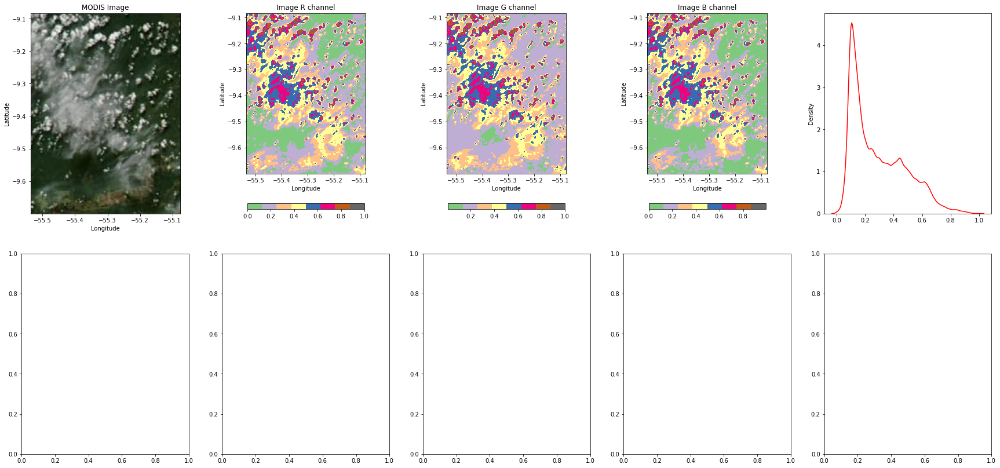

In [173]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][5, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][6, :], extent=sat.extent)

    
    f, ((ax11, ax12, ax13, ax14, ax15),
        (ax24, ax21, ax22, ax23, ax25)) =plt.subplots(2, 5, figsize=(30, 14))

    wesn= sat.extent#png[1]
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]


    ax11.imshow(img,extent=wesn)
    ax11.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax11.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax11.set_xlabel('Longitude')
    ax11.set_ylabel('Latitude')
    ax11.set_title('MODIS Image')

    cmap = 'Accent'
    cbar_karg = {'location':'bottom', 'fraction':0.05, 'shrink':0.7}
    im12 = ax12.imshow(img[:, :, 0], extent=wesn, cmap=cmap)
    ax12.set_xlabel('Longitude')
    ax12.set_ylabel('Latitude')
    ax12.set_title('Image R channel')
    f.colorbar(im12, ax=ax12, **cbar_karg)

    im13 = ax13.imshow(img[:, :, 1], extent=wesn, cmap=cmap)
    ax13.set_xlabel('Longitude')
    ax13.set_ylabel('Latitude')
    ax13.set_title('Image G channel')
    f.colorbar(im13, ax=ax13, **cbar_karg)

    im14 = ax14.imshow(img[:, :, 2], extent=wesn, cmap=cmap)
    ax14.set_xlabel('Longitude')
    ax14.set_ylabel('Latitude')
    ax14.set_title('Image B channel')
    f.colorbar(im14, ax=ax14, **cbar_karg)

    sns.kdeplot(img[:, :, 0].flatten(), ax=ax15, color='r', label='r')
    sns.kdeplot(img[:, :, 1].flatten(), ax=ax15, color='g', label='g')
    sns.kdeplot(img[:, :, 2].flatten(), ax=ax15, color='b', label='b')
    ax15.legend()
    ax15.set_title('Image RGB')

    array21 = img[:, :, 1]/img[:, :, 0]
    array21[img[:, :, 0]==0] = np.nan
    threshold21 = 1
    array21[array21>threshold21] = threshold21
    im21 = ax21.imshow(array21, extent=wesn, cmap=cmap, vmin=0.6)
    ax21.set_xlabel('Longitude')
    ax21.set_ylabel('Latitude')
    ax21.set_title('G/R')
    f.colorbar(im21, ax=ax21, extend='both', **cbar_karg)

    array22 = img[:, :, 2]/img[:, :, 0]
    array22[img[:, :, 0]==0] = np.nan
    threshold22 = 1.1
    array22[array22>threshold22] = threshold22
    im22 = ax22.imshow(array22, extent=wesn, cmap=cmap, vmin=0.9)
    ax22.set_xlabel('Longitude')
    ax22.set_ylabel('Latitude')
    ax22.set_title('B/R')
    f.colorbar(im22, ax=ax22, extend='both', **cbar_karg)

    array23 = img[:, :, 2]/img[:, :, 1]
    array23[img[:, :, 1]==0] = np.nan
    threshold23 = 1.2
    array23[array23>threshold23] = threshold23
    im23 = ax23.imshow(array23, extent=wesn, cmap=cmap, vmin=0.6)
    ax23.set_xlabel('Longitude')
    ax23.set_ylabel('Latitude')
    ax23.set_title('B/G')
    f.colorbar(im23, ax=ax23, extend='both', **cbar_karg)

    rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                            columns=['r', 'g', 'b'])
    rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
    rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
    rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
    rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
    rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
    rgb_array['b/g'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
    sns.kdeplot(rgb_array['g/r'], ax=ax24, label='g/r')
    sns.kdeplot(rgb_array['b/r'], ax=ax24, label='b/r')
    sns.kdeplot(rgb_array['b/g'], ax=ax24, label='b/g')
    ax24.legend()
    ax24.set_xlim(0, 2.5)

    sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax25, color='r', label='r')
    sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax25, color='g', label='g')
    sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax25, color='b', label='b')
    ax25.legend()
    ax25.set_title('MODIS09 RGB')

    plt.show()
    

20150622_163_225
O2A band duration: 1.6450772252735785e-06  h
[-57.9668, -57.5068, 1.6343, 2.251]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

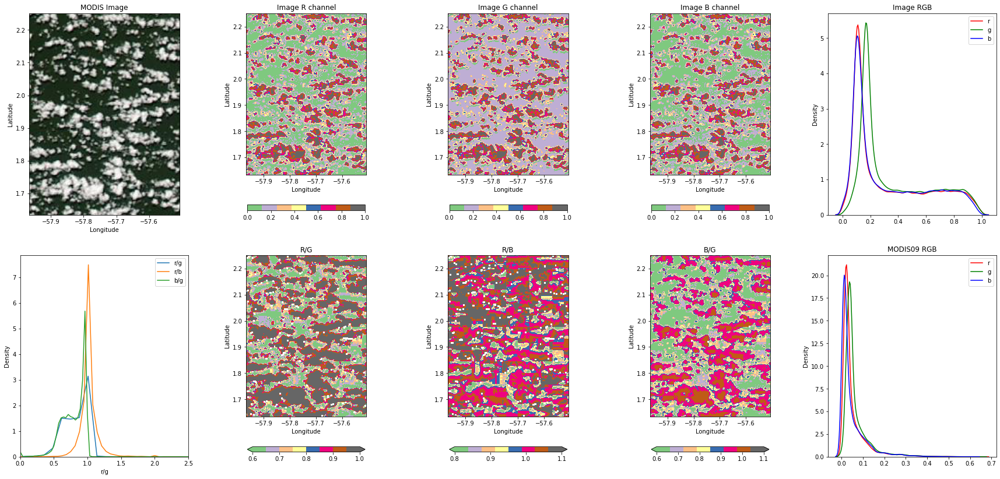

20150622_107_168
O2A band duration: 1.695726661839419e-06  h
[-57.8453, -57.3853, 1.0676, 1.6843]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

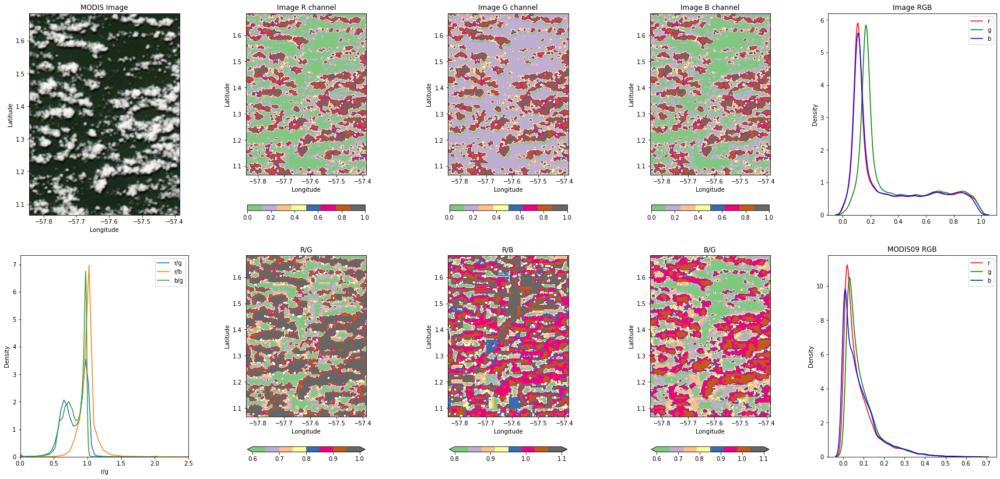

20150622_50_112
O2A band duration: 1.3014366656231383e-06  h
[-57.7238, -57.2638, 0.5009, 1.1176]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

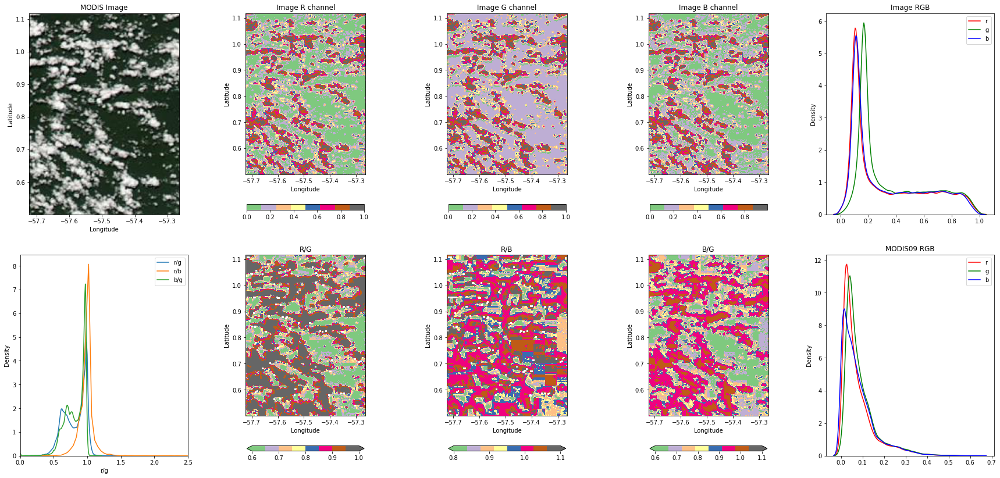

20150622_-7_55
O2A band duration: 1.1941386118350137e-06  h
[-57.6023, -57.1423, -0.0658, 0.5509]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

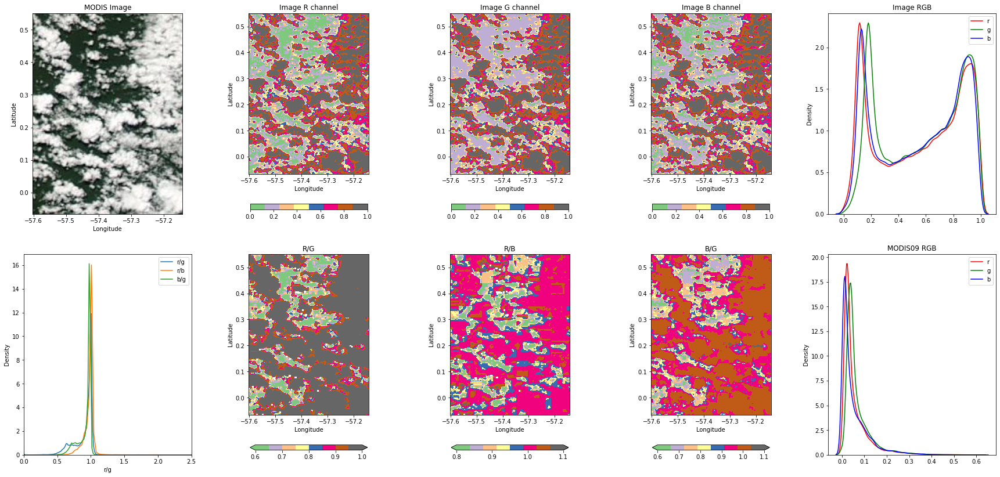

20150622_-63_-2
O2A band duration: 9.340735834686913e-06  h
[-57.4808, -57.0208, -0.6326, -0.0158]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

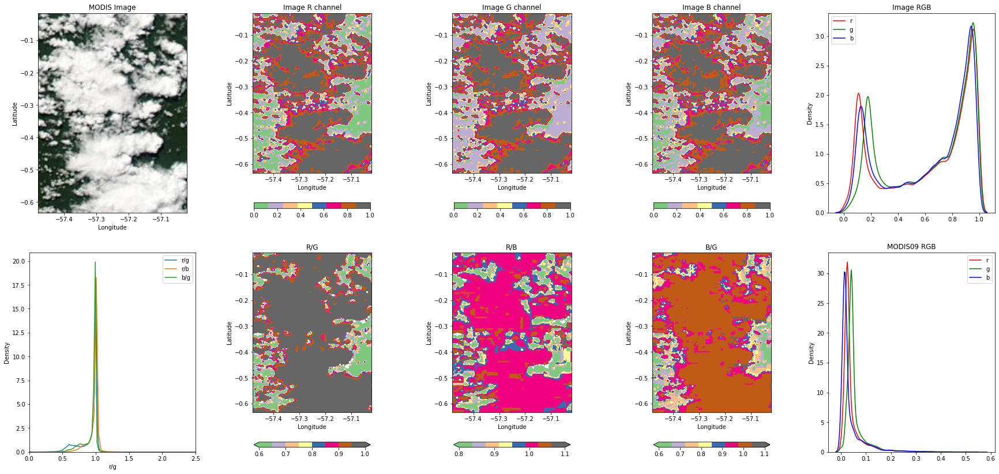

20150622_-120_-58
O2A band duration: 1.6420949961886639e-06  h
[-57.3594, -56.8994, -1.1993, -0.5826]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

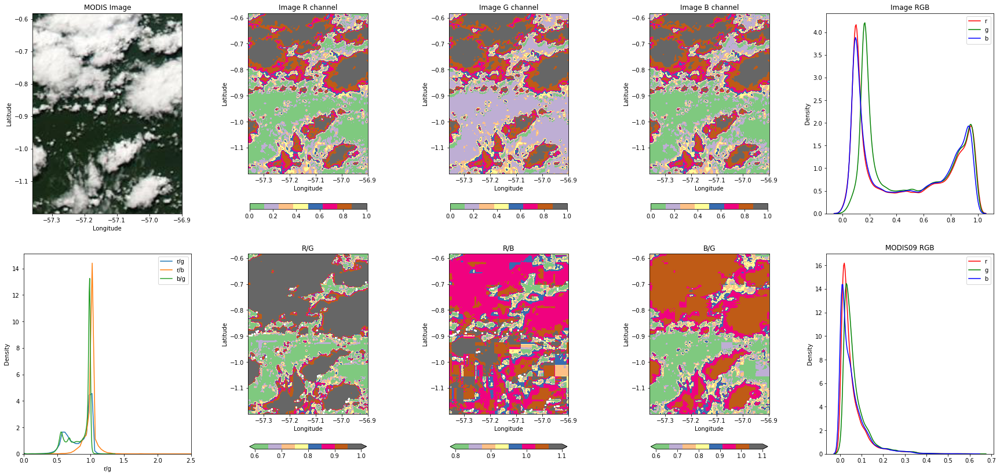

20150622_-177_-115
O2A band duration: 1.513322495156899e-06  h
[-57.2379, -56.7779, -1.766, -1.1493]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

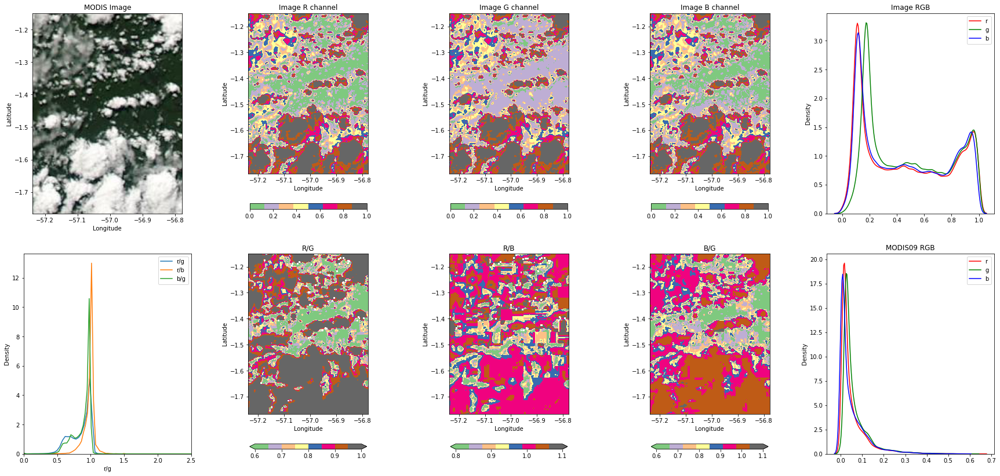

20150622_-233_-172
O2A band duration: 1.1839927740058757e-06  h
[-57.1164, -56.6564, -2.3327, -1.716]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeW

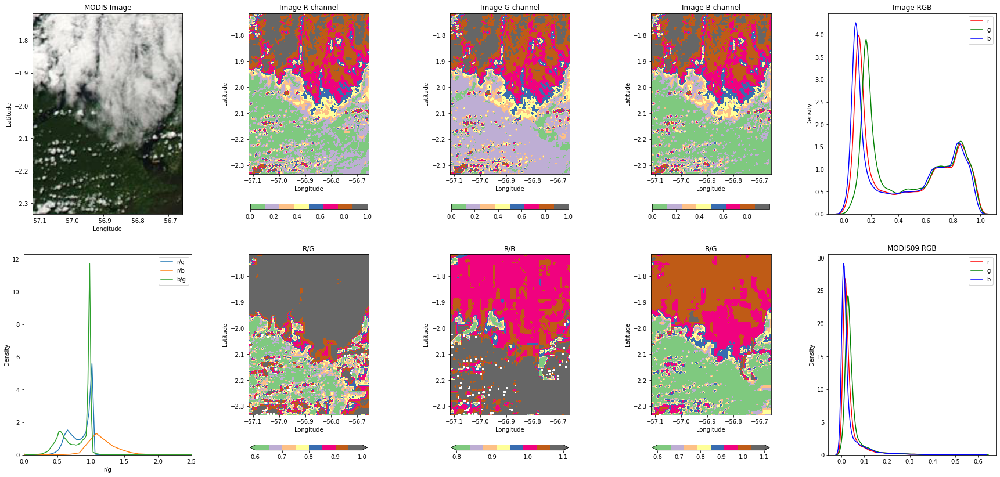

20150622_-290_-228
O2A band duration: 1.3297674983429412e-06  h
[-56.9949, -56.5349, -2.8994, -2.2827]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

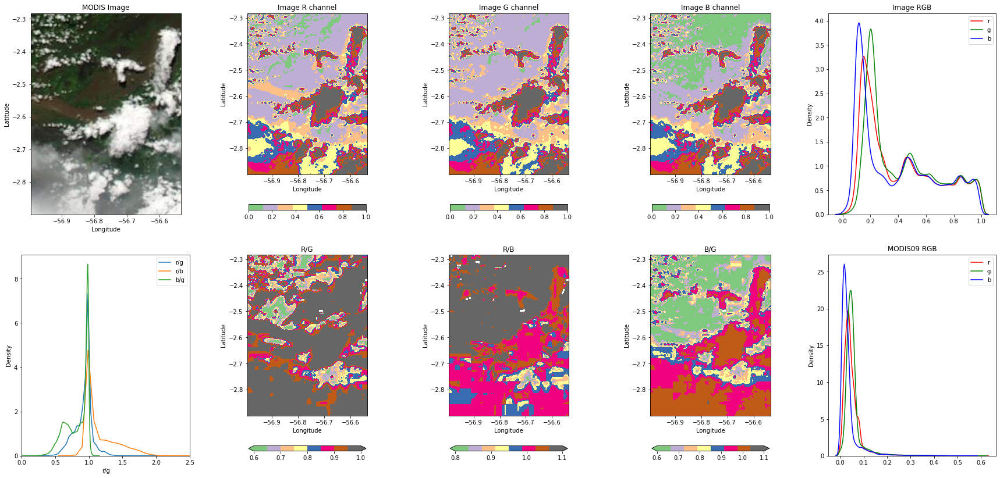

20150622_-347_-285
O2A band duration: 1.682446115106965e-06  h
[-56.8734, -56.4134, -3.4661, -2.8494]


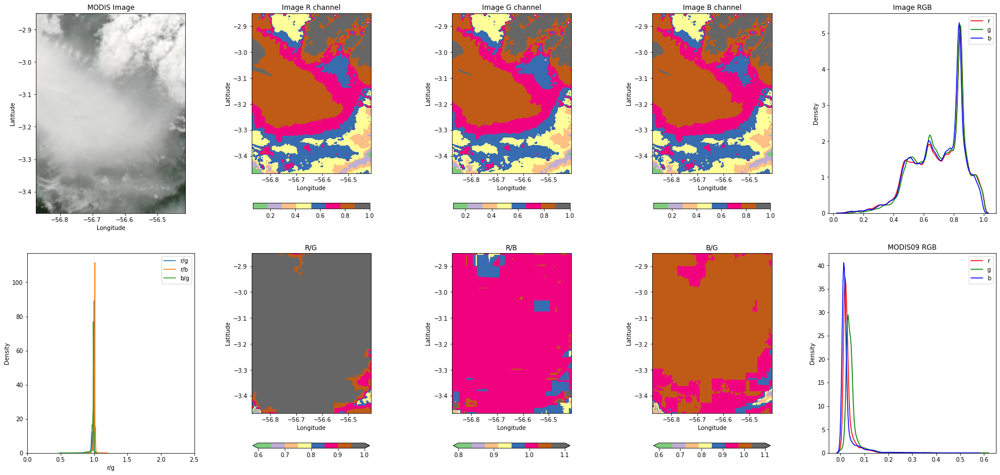

20150622_-403_-342
O2A band duration: 1.2364908373759438e-06  h
[-56.7519, -56.2919, -4.0328, -3.4161]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

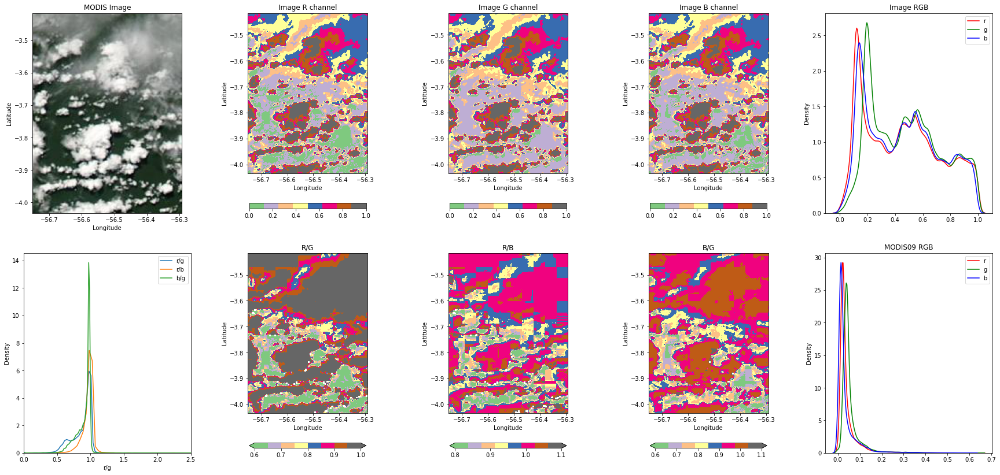

20150622_-460_-398
O2A band duration: 1.3057538874111034e-06  h
[-56.6304, -56.1704, -4.5995, -3.9828]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

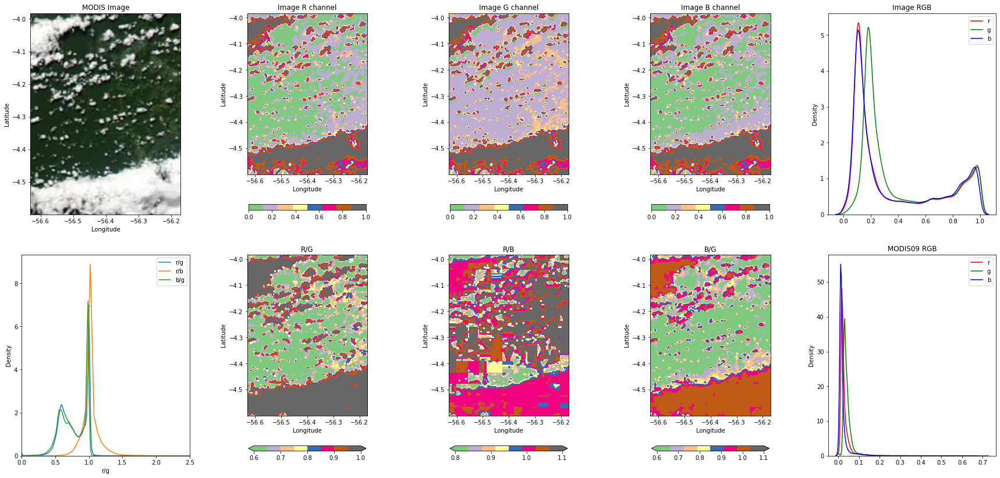

20150622_-517_-455
O2A band duration: 1.4368069484286632e-06  h
[-56.509, -56.049, -5.1662, -4.5495]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

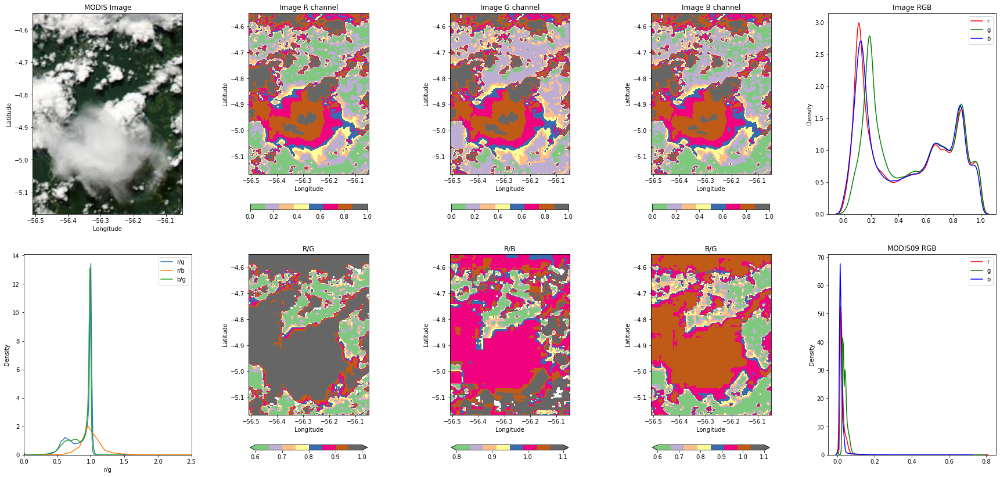

20150622_-573_-512
O2A band duration: 1.1665647212390065e-06  h
[-56.3875, -55.9275, -5.7329, -5.1162]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeW

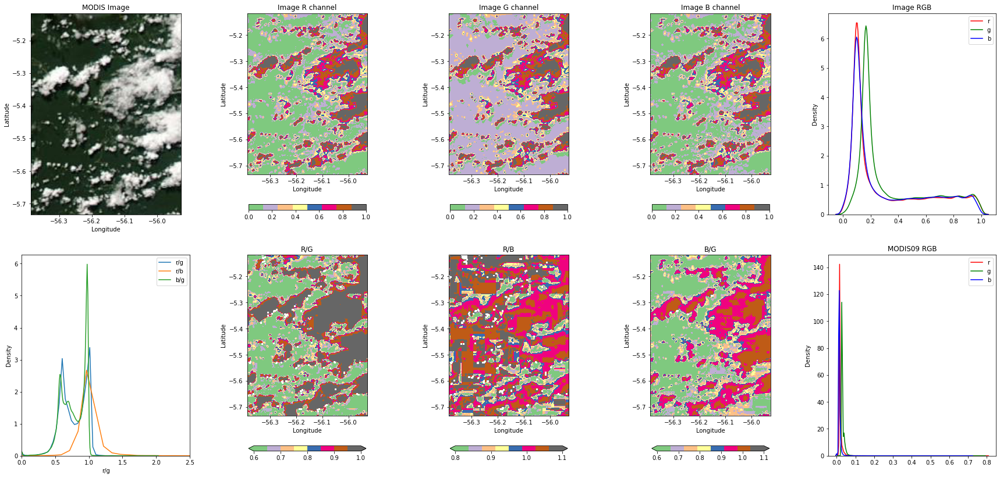

20150622_-630_-568
O2A band duration: 1.3350797235034406e-06  h
[-56.266, -55.806, -6.2997, -5.6829]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

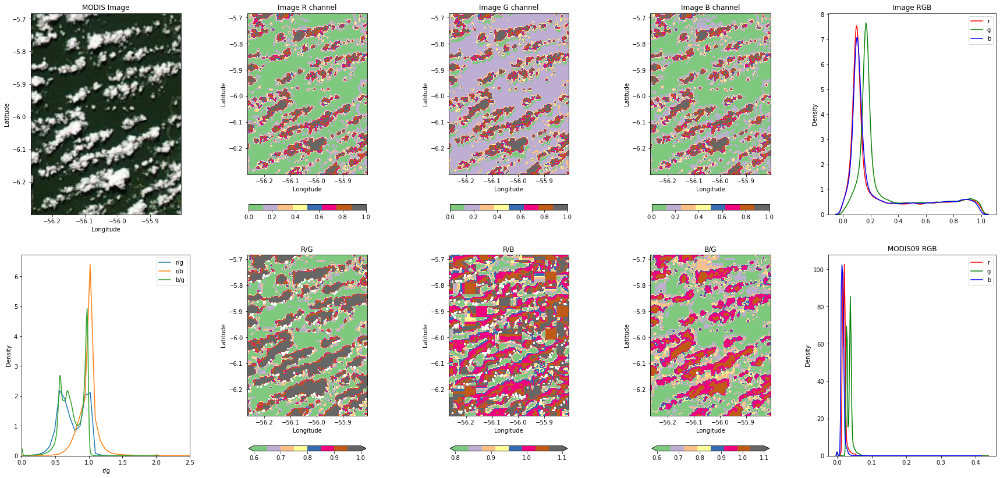

20150622_-687_-625
O2A band duration: 1.3836252765031532e-06  h
[-56.1445, -55.6845, -6.8664, -6.2497]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

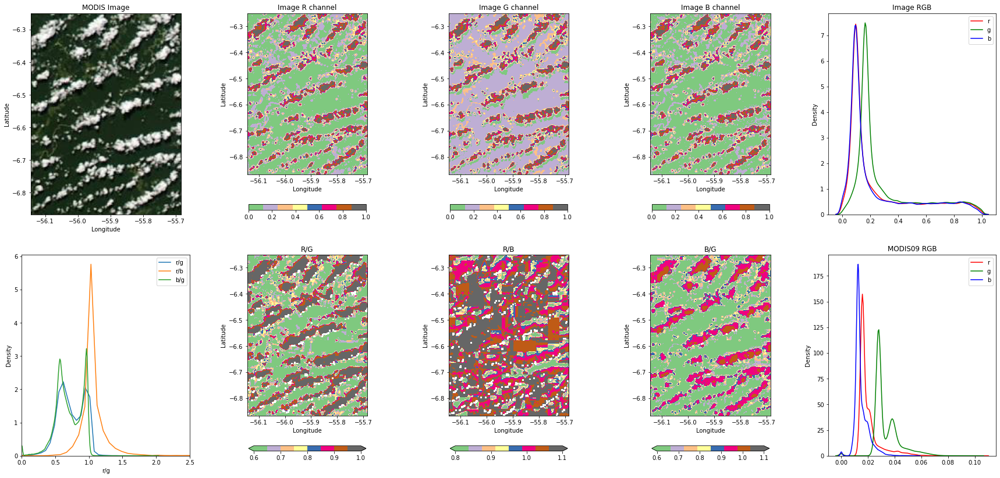

20150622_-743_-682
O2A band duration: 1.280452496656734e-06  h
[-56.023, -55.563, -7.4331, -6.8164]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

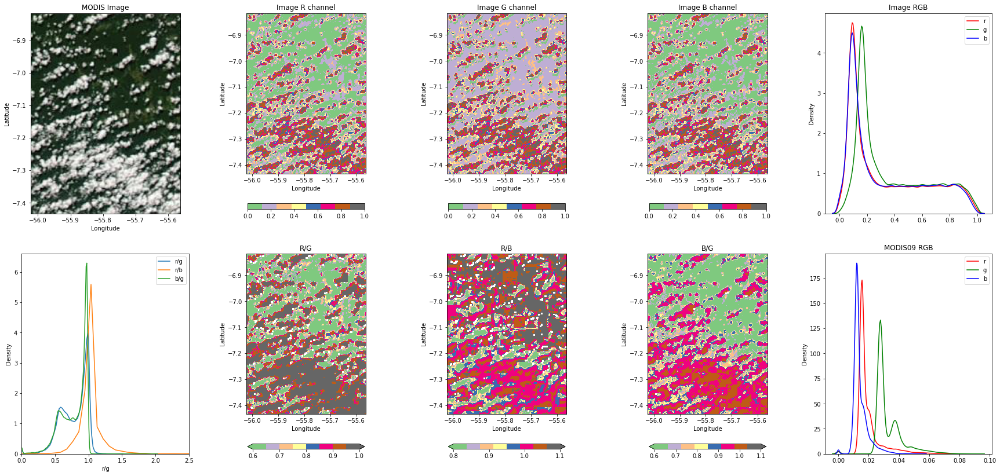

20150622_-800_-738
O2A band duration: 1.2881869446977765e-06  h
[-55.9015, -55.4415, -7.9998, -7.3831]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

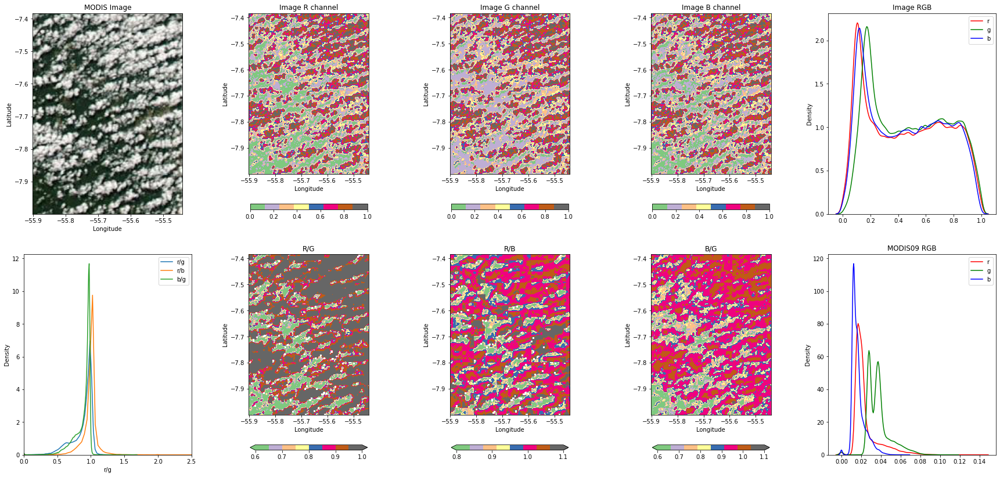

20150622_-857_-795
O2A band duration: 1.449256669729948e-06  h
[-55.78, -55.32, -8.5665, -7.9498]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

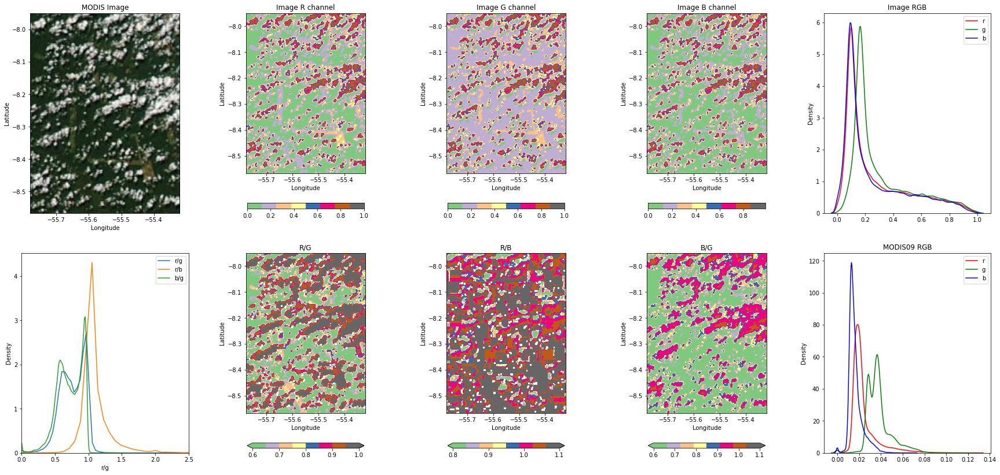

20150622_-913_-852
O2A band duration: 1.5082994408051795e-06  h
[-55.6586, -55.1986, -9.1332, -8.5165]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

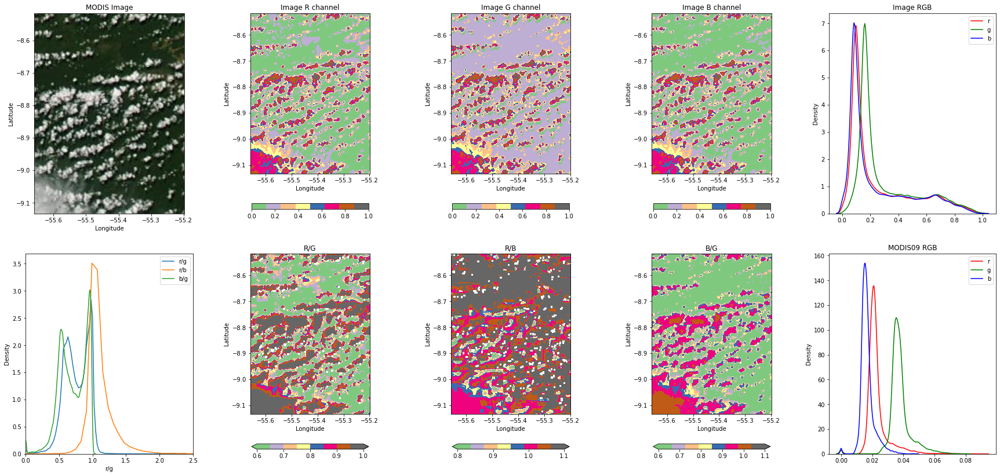

20150622_-970_-908
O2A band duration: 1.5256922213464148e-06  h
[-55.5371, -55.0771, -9.6999, -9.0832]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

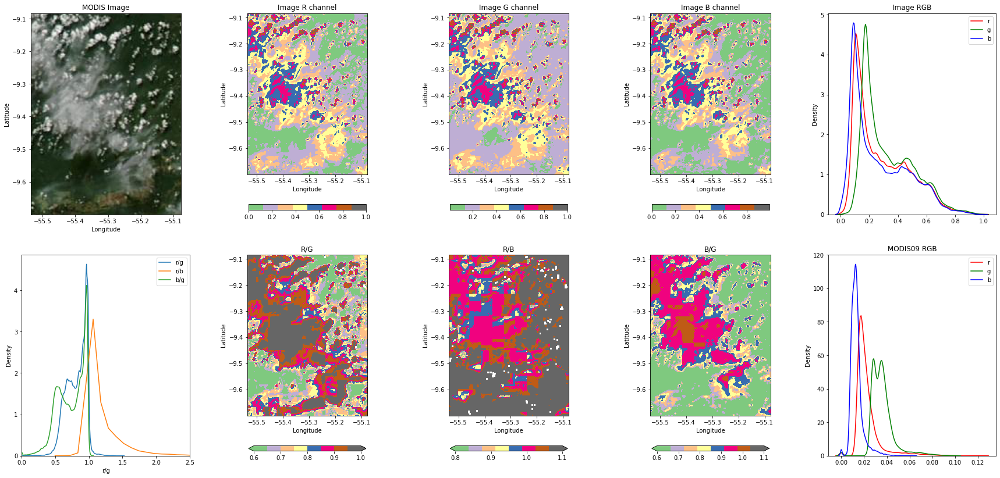

20150622_-1027_-965
O2A band duration: 1.7875786094615856e-06  h
[-55.4156, -54.9556, -10.2666, -9.6499]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


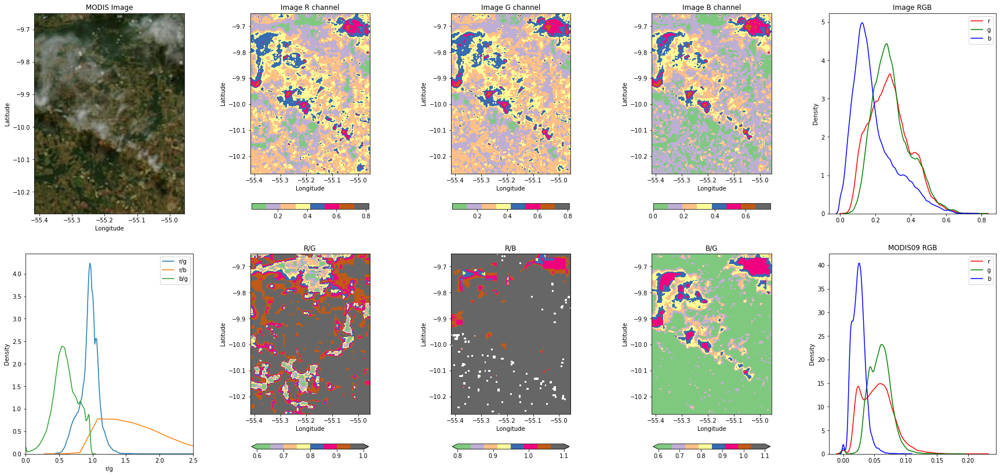

20150622_-1083_-1022
O2A band duration: 1.3615258406692496e-06  h
[-55.2941, -54.8341, -10.8333, -10.2166]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


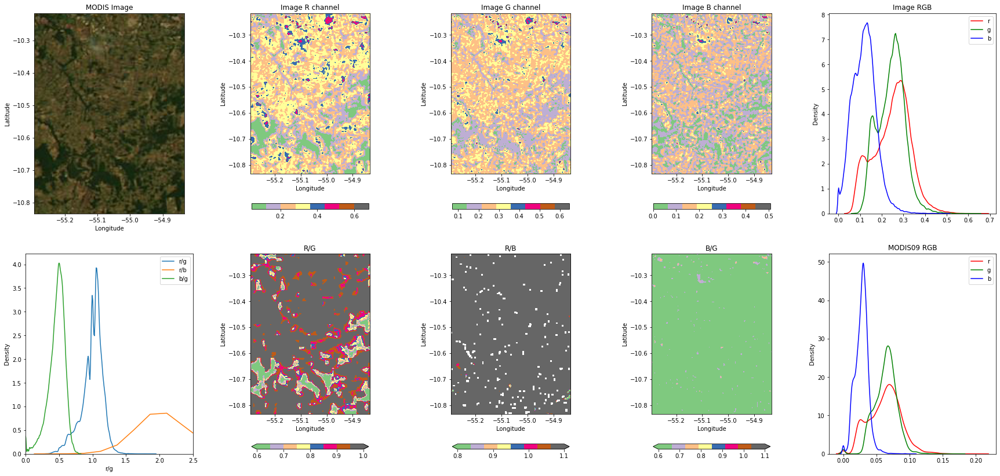

20150622_-1140_-1078
O2A band duration: 1.4401536059772803e-06  h
[-55.1726, -54.7126, -11.4, -10.7833]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


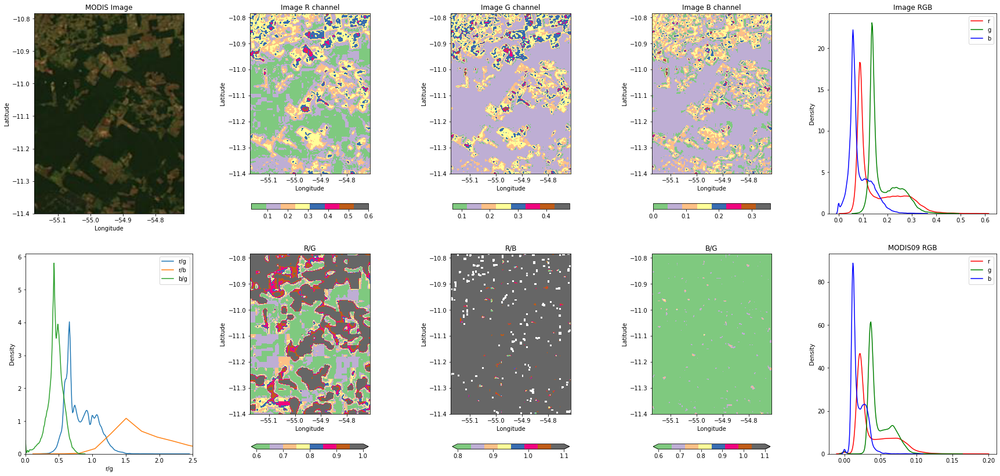

20150622_-1197_-1135
O2A band duration: 1.3840644452203479e-06  h
[-55.0511, -54.5911, -11.9668, -11.35]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

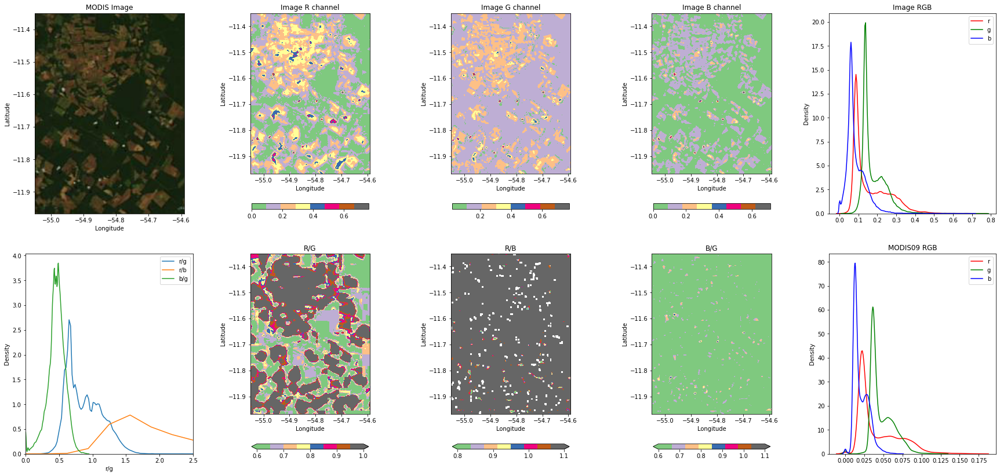

20150622_-1253_-1192
O2A band duration: 1.32724499659768e-06  h
[-54.9296, -54.4696, -12.5335, -11.9168]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


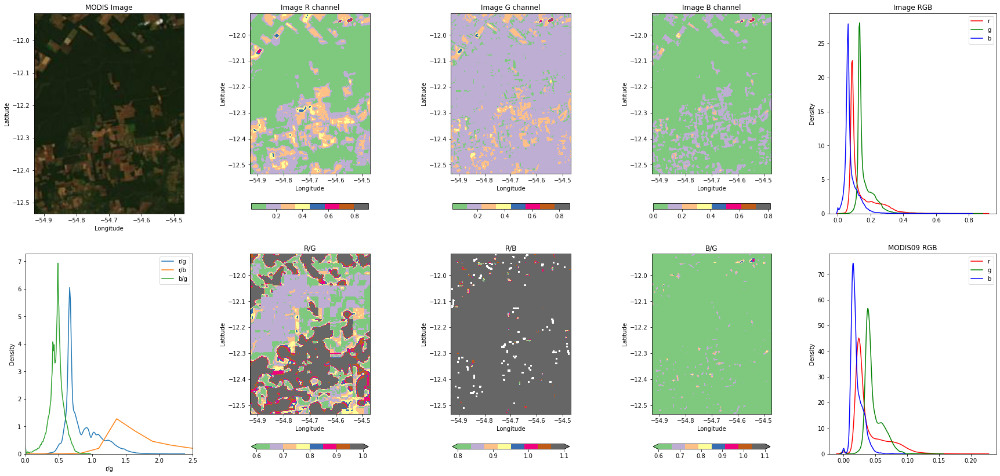

20150622_-1310_-1248
O2A band duration: 1.4900508378761717e-06  h
[-54.8082, -54.3482, -13.1002, -12.4835]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


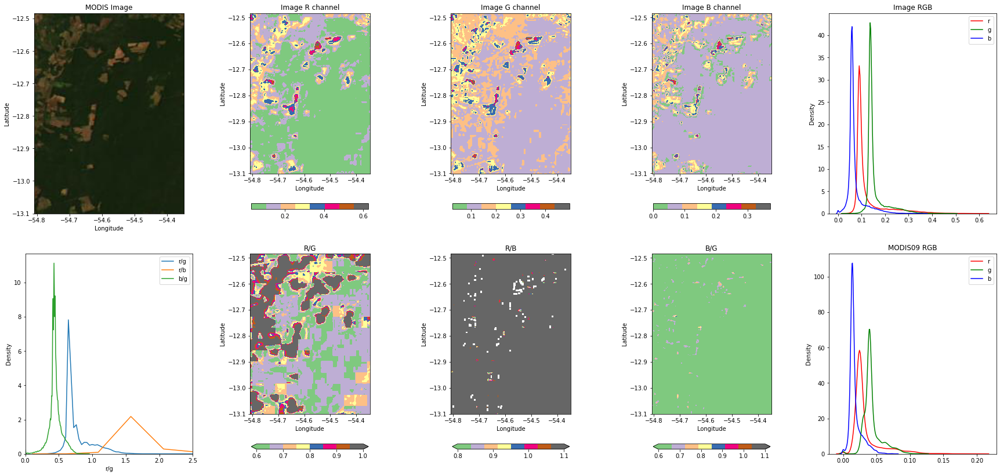

20150622_-1367_-1305
O2A band duration: 1.2181858296066316e-06  h
[-54.6867, -54.2267, -13.6669, -13.0502]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

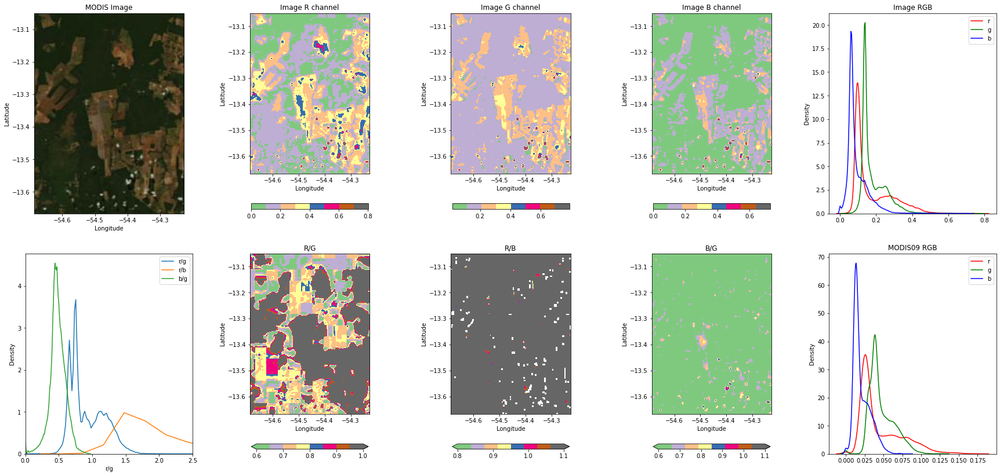

20150622_-1423_-1362
O2A band duration: 1.2618752791442806e-06  h
[-54.5652, -54.1052, -14.2336, -13.6169]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

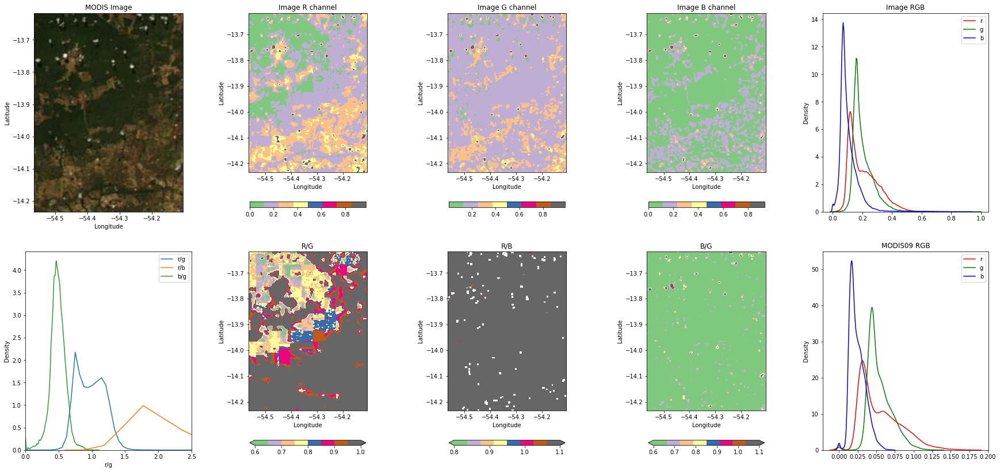

In [182]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][5, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][6, :], extent=sat.extent)

    
    f, ((ax11, ax12, ax13, ax14, ax15),
        (ax24, ax21, ax22, ax23, ax25)) =plt.subplots(2, 5, figsize=(30, 14))

    wesn= sat.extent#png[1]
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]
    print(wesn)


    ax11.imshow(img,extent=wesn)
    ax11.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax11.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax11.set_xlabel('Longitude')
    ax11.set_ylabel('Latitude')
    ax11.set_title('MODIS Image')

    cmap = 'Accent'
    cbar_karg = {'location':'bottom', 'fraction':0.05, 'shrink':0.7}
    im12 = ax12.imshow(img[:, :, 0], extent=wesn, cmap=cmap)
    ax12.set_xlabel('Longitude')
    ax12.set_ylabel('Latitude')
    ax12.set_title('Image R channel')
    f.colorbar(im12, ax=ax12, **cbar_karg)

    im13 = ax13.imshow(img[:, :, 1], extent=wesn, cmap=cmap)
    ax13.set_xlabel('Longitude')
    ax13.set_ylabel('Latitude')
    ax13.set_title('Image G channel')
    f.colorbar(im13, ax=ax13, **cbar_karg)

    im14 = ax14.imshow(img[:, :, 2], extent=wesn, cmap=cmap)
    ax14.set_xlabel('Longitude')
    ax14.set_ylabel('Latitude')
    ax14.set_title('Image B channel')
    f.colorbar(im14, ax=ax14, **cbar_karg)

    sns.kdeplot(img[:, :, 0].flatten(), ax=ax15, color='r', label='r')
    sns.kdeplot(img[:, :, 1].flatten(), ax=ax15, color='g', label='g')
    sns.kdeplot(img[:, :, 2].flatten(), ax=ax15, color='b', label='b')
    ax15.legend()
    ax15.set_title('Image RGB')

    array21 = img[:, :, 0]/img[:, :, 1]
    array21[img[:, :, 0]==0] = np.nan
    #threshold21 = 1
    #array21[array21>threshold21] = threshold21
    im21 = ax21.imshow(array21, extent=wesn, cmap=cmap, vmin=0.6, vmax=1)
    ax21.set_xlabel('Longitude')
    ax21.set_ylabel('Latitude')
    ax21.set_title('R/G')
    f.colorbar(im21, ax=ax21, extend='both', **cbar_karg)

    array22 = img[:, :, 0]/img[:, :, 2]
    array22[img[:, :, 0]==0] = np.nan
    threshold22 = 1.1
    #array22[array22>threshold22] = threshold22
    im22 = ax22.imshow(array22, extent=wesn, cmap=cmap, vmin=0.8, vmax=1.1)
    ax22.set_xlabel('Longitude')
    ax22.set_ylabel('Latitude')
    ax22.set_title('R/B')
    f.colorbar(im22, ax=ax22, extend='both', **cbar_karg)

    array23 = img[:, :, 2]/img[:, :, 1]
    array23[img[:, :, 1]==0] = np.nan
    threshold23 = 1.2
    #array23[array23>threshold23] = threshold23
    im23 = ax23.imshow(array23, extent=wesn, cmap=cmap, vmin=0.6, vmax=1.1)
    ax23.set_xlabel('Longitude')
    ax23.set_ylabel('Latitude')
    ax23.set_title('B/G')
    f.colorbar(im23, ax=ax23, extend='both', **cbar_karg)

    rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                            columns=['r', 'g', 'b'])
    rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
    rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
    rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
    rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
    rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
    rgb_array['b/g'] = np.array(rgb_array[['b']])/np.array(rgb_array[['g']])
    sns.kdeplot(rgb_array['r/g'], ax=ax24, label='r/g')
    sns.kdeplot(rgb_array['r/b'], ax=ax24, label='r/b')
    sns.kdeplot(rgb_array['b/g'], ax=ax24, label='b/g')
    ax24.legend()
    ax24.set_xlim(0, 2.5)

    sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax25, color='r', label='r')
    sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax25, color='g', label='g')
    sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax25, color='b', label='b')
    ax25.legend()
    ax25.set_title('MODIS09 RGB')

    plt.show()
    

In [263]:
same_lon, same_lat = [i[0] for i in same_list], [i[1] for i in same_list]
only_rgb_lon, only_rgb_lat = [i[0] for i in only_rgb], [i[1] for i in only_rgb]
only_ori_lon, only_ori_lat = [i[0] for i in only_ori], [i[1] for i in only_ori]

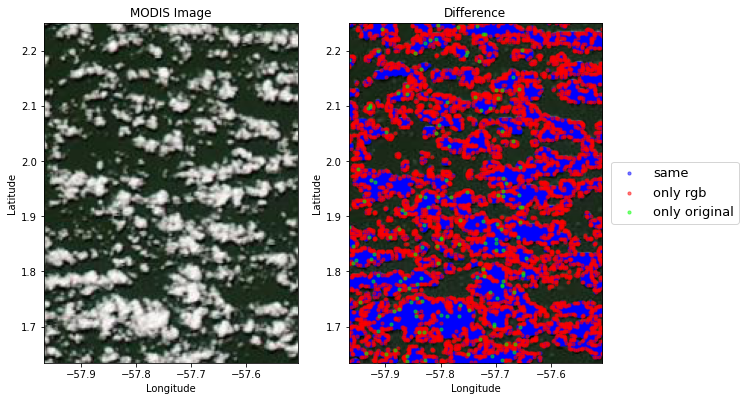

In [264]:
f, (frame1, frame2)=plt.subplots(1, 2, figsize=(10, 40))
img = png[0]
wesn= sat.extent#png[1]
img = mpimg.imread(sat.fnames['mod_rgb'][0])
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]

frame1.imshow(img,extent=wesn)
frame1.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame1.set_ylim(np.min(lat_dom), np.max(lat_dom))

frame1.set_xlabel('Longitude')
frame1.set_ylabel('Latitude')
frame1.set_title('MODIS Image')

frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))

frame2.scatter(same_lon, same_lat, s=10, edgecolor='blue', facecolor='blue',
               alpha=0.5, label='same')
frame2.scatter(only_rgb_lon, only_rgb_lat, s=10, edgecolor='r', facecolor='r',
               alpha=0.5, label='only rgb')
frame2.scatter(only_ori_lon, only_ori_lat, s=10, edgecolor='lime', facecolor='lime',
               alpha=0.5, label='only original')
frame2.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=13)
frame2.set_xlabel('Longitude')
frame2.set_ylabel('Latitude')
frame2.set_title('Difference')

plt.show()

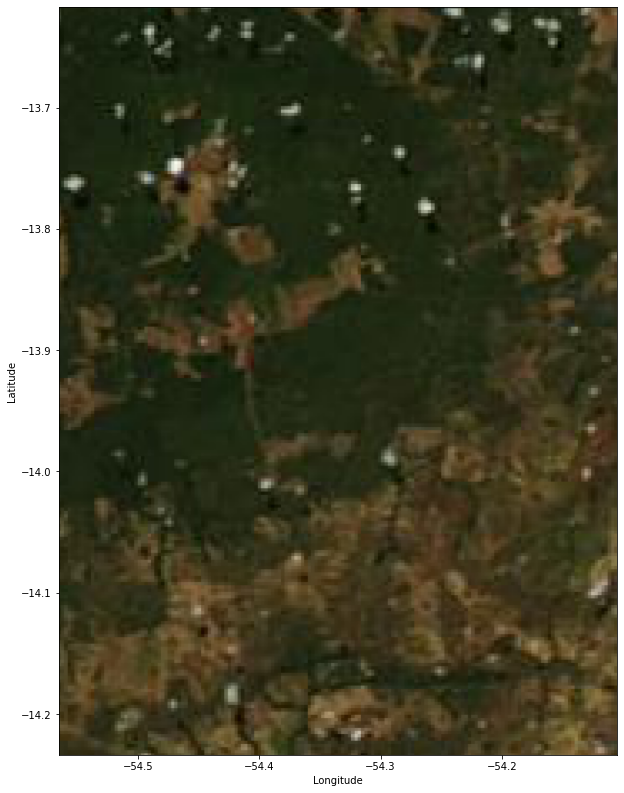

In [278]:
f,frame=plt.subplots(figsize=(10, 40))
img = png[0]
wesn= png[1]
img = mpimg.imread(sat.fnames['mod_rgb'][0])
frame.imshow(img,extent=sat.extent)
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))


"""for i in range(len(boundary_list)):
    boundary = boundary_list[i]
    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
             0.5, lat_interval, 
             frame, 'r')"""
"""for i in range(len(lon)-1):
    #frame.axvspan(lon[i], lon[i+1], lat[i], lat[i+1], alpha=0.5, color='r')
    frame.scatter(lon[i], lat[i], edgecolor='r', facecolor='none', alpha=0.5)"""
    
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [100]:
mod_rgb = mpl_img.imread(sat.fnames['mod_rgb'][0])

lon_rgb0 = np.linspace(sat.extent[0], sat.extent[1], mod_rgb.shape[1]+1)
lat_rgb0 = np.linspace(sat.extent[2], sat.extent[3], mod_rgb.shape[0]+1)
lon_rgb = (lon_rgb0[1:]+lon_rgb0[:-1])/2.0
lat_rgb = (lat_rgb0[1:]+lat_rgb0[:-1])/2.0

mod_r = mod_rgb[:, :, 0]
mod_g = mod_rgb[:, :, 1]
mod_b = mod_rgb[:, :, 2]

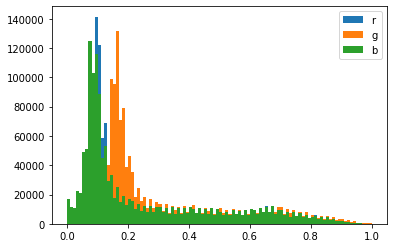

In [79]:
"""plt.hist(mod_r.flatten(), label='r', bins=100)
plt.hist(mod_g.flatten(), label='g', bins=100)
plt.hist(mod_b.flatten(), label='b', bins=100)
plt.legend()
plt.show()"""

In [101]:
rgb_array = pd.DataFrame(mod_rgb.reshape(mod_rgb.shape[0]*mod_rgb.shape[1], mod_rgb.shape[2]),
                        columns=['r', 'g', 'b', 'scale'])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])

/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


In [102]:
rgb_array

,r,g,b,scale,r/g,r/b
0,0.352941,0.364706,0.349020,1.0,0.967742,1.011236
1,0.584314,0.619608,0.600000,1.0,0.943038,0.973856
2,0.584314,0.619608,0.600000,1.0,0.943038,0.973856
3,0.584314,0.619608,0.600000,1.0,0.943038,0.973856
4,0.584314,0.619608,0.600000,1.0,0.943038,0.973856
...,...,...,...,...,...,...
1376662,0.666667,0.674510,0.670588,1.0,0.988372,0.994152
1376663,0.666667,0.674510,0.670588,1.0,0.988372,0.994152
1376664,0.666667,0.674510,0.670588,1.0,0.988372,0.994152
1376665,0.662745,0.670588,0.666667,1.0,0.988304,0.994118


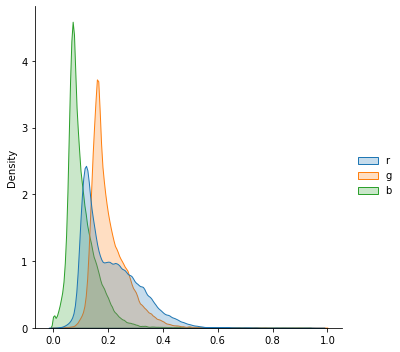

In [283]:
sns.displot(rgb_array[['r', 'g', 'b']], kind="kde", fill=True)

In [ ]:
plt.scatter()

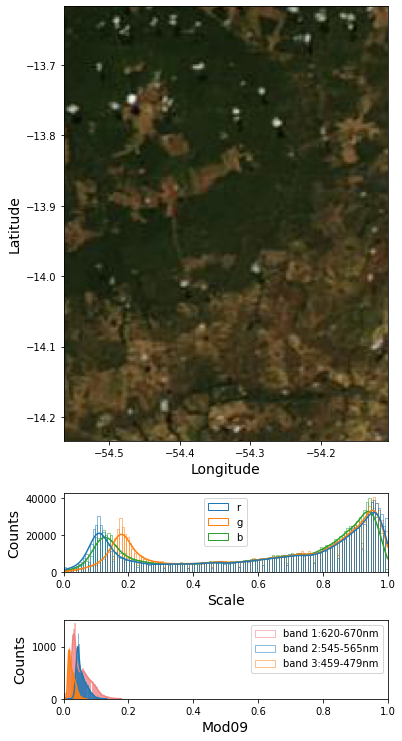

In [191]:
mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][0, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][1, :], extent=sat.extent)

fig = plt.figure(figsize=(4, 16))

x_interval = 0.25
ax10 = fig.add_axes([0.05+x_interval*0, 0.6, 0.9, 0.35])
ax20 = fig.add_axes([0.05+x_interval*0, 0.185, 0.9, 0.35])
ax30 = fig.add_axes([0.05+x_interval*0, 0.025, 0.9, 0.1])

ax11 = fig.add_axes([0.05+x_interval*1, 0.6, 0.9, 0.35])
ax21 = fig.add_axes([0.05+x_interval*1, 0.185, 0.9, 0.35])
ax31 = fig.add_axes([0.05+x_interval*1, 0.025, 0.9, 0.1])

ax12 = fig.add_axes([0.05+x_interval*2, 0.6, 0.9, 0.35])
ax22 = fig.add_axes([0.05+x_interval*2, 0.185, 0.9, 0.35])
ax32 = fig.add_axes([0.05+x_interval*2, 0.025, 0.9, 0.1])

ax13 = fig.add_axes([0.05+x_interval*3, 0.6, 0.9, 0.35])
ax23 = fig.add_axes([0.05+x_interval*3, 0.185, 0.9, 0.35])
ax33 = fig.add_axes([0.05+x_interval*3, 0.025, 0.9, 0.1])


label_size = 14

img = mpimg.imread(sat.fnames['mod_rgb'][0])
ax1.imshow(img,extent=sat.extent)
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]
ax10.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax10.set_ylim(np.min(lat_dom), np.max(lat_dom))
ax10.set_xlabel('Longitude', fontsize=label_size)
ax10.set_ylabel('Latitude', fontsize=label_size)

sns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2, color=['lightcoral', 'lightgreen', 'lightblue'])
ax20.set_xlabel('Scale', fontsize=label_size)
ax20.set_ylabel('Counts', fontsize=label_size)
ax20.set_xlim(0, 1)

ax11.


sns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm', color='lightcoral')
sns.histplot(mod_sfc_alb_2d_band4.flatten(), kde=True, fill=False, ax=ax3, label='band 2:545-565nm')
sns.histplot(mod_sfc_alb_2d_band3.flatten(), kde=True, fill=False, ax=ax3, label='band 3:459-479nm')
ax3.set_xlabel('Mod09', fontsize=label_size)
ax3.set_ylabel('Counts', fontsize=label_size)
ax3.legend()
ax3.set_xlim(0, 1)
plt.show()

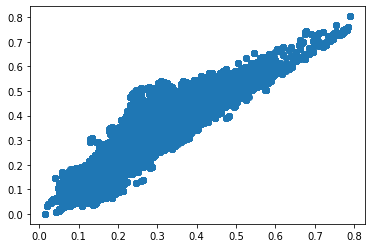

In [172]:
plt.scatter(rgb_array[['g']], rgb_array[['r']])

In [178]:
np.array(rgb_array[['r']])/np.array(rgb_array[['g']])

array([[0.75      ],
       [0.75      ],
       [0.75      ],
       ...,
       [0.87931037],
       [0.87931037],
       [0.87931037]], dtype=float32)

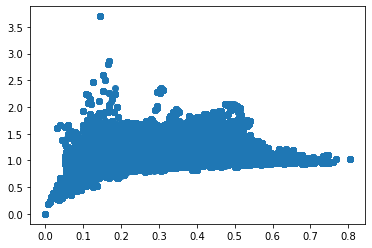

In [185]:
plt.scatter(np.array(rgb_array[['r']]), np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
           )
#plt.plot([0,10], [0,10])

In [197]:
rgb_array

,r,g,b,scale,roverg
0,0.105882,0.141176,0.066667,1.0,0.750000
1,0.105882,0.141176,0.066667,1.0,0.750000
2,0.105882,0.141176,0.066667,1.0,0.750000
3,0.105882,0.141176,0.066667,1.0,0.750000
4,0.105882,0.141176,0.066667,1.0,0.750000
...,...,...,...,...,...
1376662,0.231373,0.290196,0.215686,1.0,0.797297
1376663,0.227451,0.282353,0.207843,1.0,0.805556
1376664,0.200000,0.227451,0.164706,1.0,0.879310
1376665,0.200000,0.227451,0.164706,1.0,0.879310


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


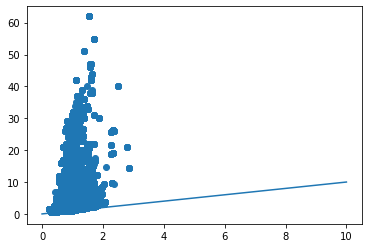

In [183]:
plt.scatter(np.array(rgb_array[['r']])/np.array(rgb_array[['g']]), 
            np.array(rgb_array[['r']])/np.array(rgb_array[['b']]))
plt.plot([0,10], [0,10])

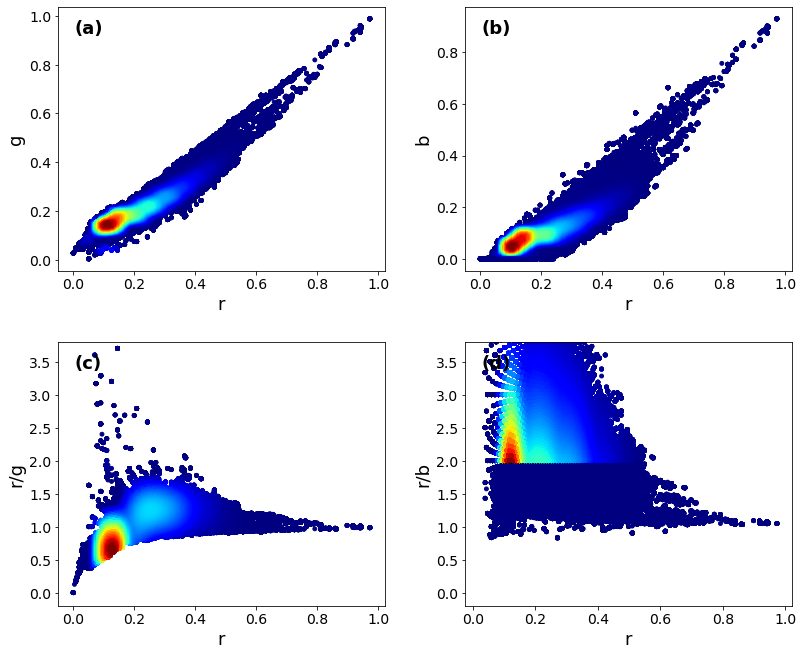

In [276]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2, 2, figsize=(12, 10), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
xy_list = [('r', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
for i in range(4):
    ax = ax_list[i]

    x = rgb_array[xy_list[i][0]]
    y = rgb_array[xy_list[i][1]]
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    
    # plot figure
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    x_array = np.array([np.min(x), np.max(x)])
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_xlabel(xy_list[i][0], fontsize=label_size)
    ax.set_ylabel(xy_list[i][1], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    if ymax>3.8:
        ymax = 3.8
        ax.set_ylim(ymin, ymax)
    if ymin<-0.2:
        ymin = -0.2
        ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')